<a href="https://colab.research.google.com/github/einsteinxx/UCLA_BIOENG224B_SPRING2020/blob/master/Patch_GradingwAnimate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

  **Purpose: This code will read in a selection of cell slide images and generate patches that are likely to include the highest density of cells and/or easily distinguished cells.**


---


  To use: Modify data directory to point to BCD folders and run-all. Data should
match the BCD4\ formats (severity\Anon\patient id\raw images). Alter the data
folder read section if using another format (the dictionaries created will 
look different then). The sharpness calculation will run over any raw images passed into it, but the statistics used for outputting are specific to BE224 datasets (will need to alter if using a different dataset).

  Easiest use is on Google Colab (alter data directory setup to run locally - if/else has area for local drives to be added). In CoLab, Runtime->Run-All should get everything going (will pause, asking for credentials to a GDrive)

In [81]:
'''
Find Good Patches

'''

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 600

### Imports
%matplotlib inline 
#inline




import os
import sys
import random
import math
import string
import re
import time
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg 
import matplotlib.patches as patches
import imageio
from pathlib import Path             #file path tools
from shapely.geometry import Polygon #make polygons for Intersections
from PIL import Image  

import json
import pandas as pd

import csv

from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
import pickle


In [82]:
'''
Data directories
'''

use_google_colab = 1 #toggle COLAB setup 
image_type = 0 #0=BCD
if (use_google_colab == 1):
    ############################################################################
    # Read Data from google drive
    ############################################################################
    from google.colab import drive #for loading gdrive data
    drive.mount('/content/gdrive')

    ###                     MAIN DIRECTORY NAMES
    gdir = '/content/gdrive/My Drive/'
    main_directory = gdir


    if (image_type == 0):
        #main directory for test_prediction_data set
        tp_dir = os.path.join(gdir,'BE224B_2020','Central BCD4')
        output_patch_pickle = os.path.join(gdir,'BE224B_2020','output_patch.pck')
        output_border_pickle = os.path.join(gdir,'BE224B_2020','output_border.pck')
        row_locations = os.path.join(gdir,'BE224B_2020','Zrow_col.csv')

        bounding_box_file = os.path.join(gdir,'BE224B_2020','BCD','metadata.csv')

        #animation folder
        animate_image = 1
        animation_dir = os.path.join(gdir,'ANIMATE_BCD4')

    else:
        print('Incorrect Image Type selected')
        sys.exit()

else:
    ############################################################################
    # Read Data from local drive
    ############################################################################
    print('INSERT LOCAL DRIVE INFO')
    sys.exit()


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [83]:
#
# CSV data was processed separately. Import that and sync the files to the raw
#image file order
#

original_files = [('data/Central BCD4/Severe/Anonymized/87-38/87-38-35.jpg'),
 ('data/Central BCD4/Severe/Anonymized/87-37/87-37.jpg'),		
 ('data/Central BCD4/Severe/Anonymized/87-3/87-3-64.jpg'),		
 ('data/Central BCD4/Severe/Anonymized/87-2/87-2-22.jpg'),		
 ('data/Central BCD4/Severe/Anonymized/39-13/39-13-24.jpg'),	
 ('data/Central BCD4/Severe/Anonymized/39-13/39-13-22.jpg'),
 ('data/Central BCD4/Severe/Anonymized/39-12/39-12-28.jpg'),
 ('data/Central BCD4/Severe/Anonymized/14-6/14-6-23.jpg'),		
 ('data/Central BCD4/Severe/Anonymized/14-6/14-6-18.jpg'),		
 ('data/Central BCD4/Moderate/Anonymized/76-8/76-8-27.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/76-7/76-7-32.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/76-7/76-7-26.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/50-9/50-9-19.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/50-9/50-9-18.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/4-18/4-18-22.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/4-18/4-18-21.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/4-18/4-18-19.jpg'),	
 ('data/Central BCD4/Moderate/Anonymized/4-1/4-1-24.jpg'),		
 ('data/Central BCD4/Moderate/Anonymized/4-1/4-1-23.jpg'),		
 ('data/Central BCD4/Moderate/Anonymized/4-1/4-1-22.jpg'),		
 ('data/Central BCD4/Mild/Anonymized/74-2/74-2-18.jpg'),
 ('data/Central BCD4/Mild/Anonymized/74-2/74-2-17.jpg'),
 ('data/Central BCD4/Mild/Anonymized/74-1/74-1-28.jpg'),
 ('data/Central BCD4/Mild/Anonymized/65-2/65-2-15.jpg'),
 ('data/Central BCD4/Mild/Anonymized/65-1/65-1-37.jpg'),
 ('data/Central BCD4/Mild/Anonymized/65-1/65-1-36.jpg'),
 ('data/Central BCD4/Mild/Anonymized/50-54/50-54-25.jpg'),
 ('data/Central BCD4/Mild/Anonymized/50-53/50-53-33.jpg'),
 ('data/Central BCD4/Mild/Anonymized/50-53/50-53-32.jpg'),
 ('data/Central BCD4/Mild/Anonymized/12-1/12-1-24.jpg'),
 ('data/Central BCD4/Mild/Anonymized/12-0/12-0-34.jpg'),
 ('data/Central BCD4/Control/Anonymized/N3-2/N3-2-32.jpg'),
 ('data/Central BCD4/Control/Anonymized/N3-1/N3-1-31.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N3-1/N3-1-30.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N2-6/N2-na-od-6-21.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N2-0/N2-na-od-0-26.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N2-0/N2-na-od-0-25.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N1-46/N1-46-17.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N1-46/N1-46-16.jpg'),
 ('data/Central BCD4/Control/Anonymized/N1-2/N1-2-31.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N1-2/N1-2-30.jpg'),	
 ('data/Central BCD4/Control/Anonymized/N1-1/N1-1.jpg')]

ordered_files = []
for filename in original_files:
    fname = os.path.basename(filename)
    #root_ext = os.path.splitext(filename) #will return two parts, name and ext
    #keyname = root_ext[0] #dump the extension for the key 
    ordered_files.append(fname)
print(ordered_files)


['87-38-35.jpg', '87-37.jpg', '87-3-64.jpg', '87-2-22.jpg', '39-13-24.jpg', '39-13-22.jpg', '39-12-28.jpg', '14-6-23.jpg', '14-6-18.jpg', '76-8-27.jpg', '76-7-32.jpg', '76-7-26.jpg', '50-9-19.jpg', '50-9-18.jpg', '4-18-22.jpg', '4-18-21.jpg', '4-18-19.jpg', '4-1-24.jpg', '4-1-23.jpg', '4-1-22.jpg', '74-2-18.jpg', '74-2-17.jpg', '74-1-28.jpg', '65-2-15.jpg', '65-1-37.jpg', '65-1-36.jpg', '50-54-25.jpg', '50-53-33.jpg', '50-53-32.jpg', '12-1-24.jpg', '12-0-34.jpg', 'N3-2-32.jpg', 'N3-1-31.jpg', 'N3-1-30.jpg', 'N2-na-od-6-21.jpg', 'N2-na-od-0-26.jpg', 'N2-na-od-0-25.jpg', 'N1-46-17.jpg', 'N1-46-16.jpg', 'N1-2-31.jpg', 'N1-2-30.jpg', 'N1-1.jpg']


In [84]:
def animate():
    import matplotlib.animation as animation
    import os

    plt.close()
    plt.rcParams["animation.html"] = "jshtml"

    #plt.figure()
    #plt.imshow(stack[:,:,300])
    fig=plt.figure()
    #plt.imshow(stack[:,:,255])
    ims = []
    dir_name = "/home/kgonzalez/IMAGES"
    base_filename = "figure"
    filename_suffix = ".png"
    for ii in range(0,512):
            im = plt.imshow(stack[:,:,ii], animated=True)
            ims.append([im])
            plt.imshow(stack[:,:,ii],cmap='gray')
            name = os.path.join(dir_name, base_filename + str(ii).zfill(5)  + filename_suffix)
            
            plt.savefig(name) # save as png

    ani = animation.ArtistAnimation(fig, ims, interval=1000, blit=True,
                                    repeat_delay=500)

In [85]:
def animate2():
    import matplotlib.animation as animation

    fig, ax = plt.subplots()

    x = np.arange(0, 2*np.pi, 0.01)
    line, = ax.plot(x, np.sin(x))


    def init():  # only required for blitting to give a clean slate.
        line.set_ydata([np.nan] * len(x))
        return line,


    def animate(i):
        line.set_ydata(np.sin(x + i / 100))  # update the data.
        return line,


    ani = animation.FuncAnimation(
        fig, animate, init_func=init, interval=2, blit=True, save_count=50)

    # To save the animation, use e.g.
    #
    # ani.save("movie.mp4")
    #
    # or
    #
    # from matplotlib.animation import FFMpegWriter
    # writer = FFMpegWriter(fps=15, metadata=dict(artist='Me'), bitrate=1800)
    # ani.save("movie.mp4", writer=writer)

    plt.show()


In [86]:
def write_frame(max_col, max_row, box_length,imdata, animation_dir,image_number,base_name):
    #write an image to be part of the animation set


    #
    # Define box coordinates
    #
    left_wall = max_col - box_length
    right_wall = max_col + box_length
    low_wall = max_row - box_length
    high_wall = max_row + box_length


    #define square for plotting over the image
    rect = patches.Rectangle((left_wall,low_wall),box_length*2,box_length*2,linewidth=3,edgecolor='r',facecolor='none')

    # Get the current reference
    ax = plt.gca()
    # Add the patch to the Axes
    ax.add_patch(rect)

    user_data_found = 0
    if (user_data_found == 1):
        #define square for original box choice
        user_rect = patches.Rectangle((user_left, user_bottom),user_x,user_y,linewidth=3,edgecolor='red',facecolor='none')
        ax.add_patch(user_rect)
    #else:
    #    print('MISSING USER DEFINED BOX DATA')

    #ax.legend(['Automated','Manual'],fancybox=True, framealpha=0.4)
   # plt.show()


    #fig=plt.figure()

    ims = []
    dir_name = animation_dir
    base_filename = "figure"
    filename_suffix = ".png"

    plt.imshow(imdata, animated=True)
    name = os.path.join(dir_name, base_name + '_'+ str(image_number).zfill(5)  + filename_suffix)
        
    plt.savefig(name) # save as png
    plt.close()


In [87]:
def read_csv_data(full_filename,header=1):
#read in csv data and store in a dictionary

    csv_data=[]

    with open(full_filename) as csvfile:
        csv_reader = csv.reader(csvfile, delimiter=',')
        if (header == 1):
            next(csv_reader, None)  # skip the header
        for row in csv_reader:
            #if line_count == 0:
            csv_data.append(row) #(np.array(row,dtype=float))
    return csv_data

In [88]:
def read_bounding_boxes(csv_file):
    csv_data = read_csv_data(csv_file)

    return csv_data

In [89]:
def assign_table(bounding_box_file):
    csv_data = read_bounding_boxes(bounding_box_file)

    id = []
    table_data = []
    for counter,datarow in enumerate(csv_data):
        row_id = datarow[2]
        if row_id in id:
            continue
        else: #add to the list along with all its data once
            id.append(row_id)
            table_data.append(datarow)
        
    ulist = set(id)

    flist=[]
    for counter,ii in enumerate(ulist):
        flist.append(int(ii))

    print(flist)
    return id,table_data

In [90]:
id,table_data = assign_table(bounding_box_file)

[1, 40, 10, 34, 25, 37, 31, 21, 14, 26, 38, 29, 2, 28, 15, 18, 3, 42, 35, 5, 30, 43, 16, 41, 44, 7, 32, 24, 17, 19, 23, 36, 0, 4, 12, 6, 20, 33, 22, 8, 27, 11]


In [91]:
########################################################################
#get full width half maximum for an idea of usable contrast range
########################################################################
def get_fwhm(small_image,num_bins=30):
    hist,bedges=np.histogram(small_image,bins=num_bins)

    max_val = max(hist)
    center = np.argwhere(hist == max_val)
    center_value = hist[center[0]]
    
    bins = bedges
    n=hist
    mids = 0.5*(bins[1:] + bins[:-1])
    probs = n / np.sum(n)

    mean = np.sum(probs * mids)  

    #Standard Deviation
    sd = np.sqrt(np.sum(probs * (mids - mean)**2))


    fwhm = []
    dx = np.diff(bins)
    for count, ii in enumerate(hist):
        if (ii >= center_value/2.0):
            midbin = bins[count] + dx[0]/2 #bins[count]- bins[count-1]
            fwhm.append(midbin)

    return fwhm

#####################################################################

In [92]:
#####################################################################
# Get blobs to detect if we're in an image with any cells or 
#cell-like shapes present. This protects us from areas with contrast
#edges that are not cell boundaries. Cell shapes in these images are
#extremely variable (some are spherical, some highly stretched). The
#paramaters here are chosen for the ideal cells and may not fully 
#capture some of the oddly shaped cells and can sometimes fixate on
#outside tissue in a spherical shape
#
#####################################################################
def get_blobs(small_image,low_contrast,high_contrast):

    params = cv2.SimpleBlobDetector_Params()
    # Change thresholds
    params.minThreshold = low_contrast #10;
    params.maxThreshold = high_contrast #200;
    # Filter by Area.
    params.filterByArea = True
    params.minArea = 10
    # Filter by Circularity
    params.filterByCircularity = True
    params.minCircularity = 0.5
    # Filter by Convexity
    params.filterByConvexity = True
    params.minConvexity = 0.75 #0.87
    # Filter by Inertia
    params.filterByInertia = True
    params.minInertiaRatio = 0.05 #0.01
    # Create a detector with the parameters
    ver = (cv2.__version__).split('.')
    if int(ver[0]) < 3 :
        detector = cv2.SimpleBlobDetector(params)
    else :
        detector = cv2.SimpleBlobDetector_create(params)

    # Detect blobs.
    keypoints = detector.detect(small_image)
    im_with_keypoints = cv2.drawKeypoints(small_image, keypoints, np.array([]), (0,200,0), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)



    return im_with_keypoints

In [93]:
################################################################################
# Get a square matrix of data given an initial center point and box size. Edge
# areas will return the biggest square possible
################################################################################
def get_square(data_in, row, col,dlength):
    #get a cross of data to test
    lowrow = row-dlength
    highrow = row + dlength
    lowcol = col - dlength
    highcol = col + dlength

    #get border limits
    nsize = np.shape(data_in)
    nrow = nsize[0]
    ncol = nsize[1]

    if ( (row - dlength ) < 0):
        #return a smaller value
        lowrow = 0
    if ( (row + dlength ) > nrow):
        #return a smaller value
        highrow = nrow -1
    if ( (col- dlength ) < 0):
        #return a smaller value
        lowcol = 0
    if ( (col + dlength ) > ncol):
        #return a smaller value
        highcol = ncol -1

    row_data = data_in[lowrow:highrow,col]
    col_data = data_in[row,lowcol:highcol]


    submatrix = data_in[lowrow:highrow,lowcol:highcol]
    return submatrix

In [94]:
################################################################################
# Get intersection over union for two regions
################################################################################
def calculate_ioveru(box1, box2):
    polygon1 = Polygon(box1)
    polygon2 = Polygon(box2)
    iou = polygon1.intersection(polygon2).area / polygon1.union(polygon2).area
    return iou


In [95]:
'''
Get data folders
'''
if (image_type == 0):
    severity_list = os.listdir(tp_dir)

    patient_folder={}
    for sname in severity_list:
        full_path = os.path.join(tp_dir,sname)
        subfolder = os.listdir(full_path)
        print(subfolder)
        patient_folder[sname]=[]
        for ii in subfolder:
            patient_folder[sname].append(ii)
elif(image_type == 1):
    subfolder_list = os.listdir(image_dir)    
else:
    print('default case')
    subfolder_list = os.listdir(image_dir)


['74-os-1', 'Anonymized', '65-od-1', '50-os-54', '12-od-0', '65-od-2', '74-os-2', '50-os-53', '12-od-1', '12-od-2']
['39-od-13', '14-od-6', '87-od-3', 'Anonymized', '87-os-38', '87-os-37', '87-od-2', '14-od-5', '39-od-12']
['4-od-18', '76-od-7', 'Anonymized', '76-od-8', '4-os-1', '50-od-9']
['N1-od-2', 'N2-od-0', 'N3-od-2', 'Anonymized', 'N1-os-46', 'N3-od-1', 'N1-od-1', 'N2-od-6', 'N1-os-47']


In [96]:
'''
Load the data by severity folders or aggregate folders
'''

if (image_type == 0):

    #BCD2 image set,just use the anon folder data
    im={}
    mini_im={} #subset images from counter image file
    extracted_2nd_image ={} #larger subset image from counter file
    rr ={}
    cc ={}

    full_patient_list ={}
    for sname in severity_list:
        folders = patient_folder[sname]
        full_patient_list[sname] ={}

        #
        # We are concerned with ANON folders for the annotation
        #
        for folder_name in folders:
            if 'ANON' in folder_name.upper():
                full_patient_list[sname][folder_name] = os.path.join(tp_dir,sname,folder_name)
            else:
                full_patient_list[sname][folder_name] = os.path.join(tp_dir,sname,folder_name)

    #
    # Get file listing
    #
    patient_files ={} #hold the anon images
    case_files = {} #hold files for each case folder
    for sname in full_patient_list.keys(): #severity folders
        patient_files[sname]= []
        case_files[sname] ={}

        #if 'ANON' in sname.upper():
            #get files only from anonymous folders
        for sub_dir in full_patient_list[sname]:
            if 'ANON' in sub_dir.upper():

                case_files[sname][sub_dir] ={} #just using Anonymous folder for now
                patient_dir = os.path.join(tp_dir,sname,sub_dir)
                case_dir = os.listdir(patient_dir)
                patient_files[sname].append(case_dir)


                for case_name in case_dir:
                    case_files[sname][sub_dir][case_name] = []
                    full_path = os.path.join(tp_dir,sname,sub_dir, case_name)
                    temp_list = os.listdir(full_path)
                    for filename in temp_list: #get all files within pt folder  
                        case_files[sname][sub_dir][case_name].append(filename)
            else: #series of images
                continue  #stick with ANON for now
                case_files[sname][sub_dir] ={} #individual patient folders
                patient_dir = os.path.join(tp_dir,sname,sub_dir)
                case_dir = os.listdir(patient_dir)
                patient_files[sname].append(case_dir)

                for case_name in case_dir:
                    case_files[sname][sub_dir][case_name] = []
                    full_path = os.path.join(tp_dir,sname,sub_dir, case_name)
                    temp_list = os.listdir(full_path)
                    for filename in temp_list: #get all files within pt folder  
                        case_files[sname][sub_dir][case_name].append(filename)

    for sname in case_files.keys():
        im[sname] = {}
        mini_im[sname] = {}
        extracted_2nd_image[sname] = {}
        rr[sname]={}
        cc[sname] ={}

        #im[sname]['ANON'] = {}
        for case_name in case_files[sname].keys():
            im[sname][case_name] = {}
            mini_im[sname][case_name] = {}
            extracted_2nd_image[sname][case_name] = {}
            rr[sname][case_name] = {}
            cc[sname][case_name] = {}

            print(case_files[sname].keys())
            for pt_dir in case_files[sname][case_name]:
                
                im[sname][case_name][pt_dir] = {}
                mini_im[sname][case_name][pt_dir] = {}
                extracted_2nd_image[sname][case_name][pt_dir] = {}
                rr[sname][case_name][pt_dir] = {}
                cc[sname][case_name][pt_dir] = {}

                print('patient directory is ', pt_dir)
                image_files = os.listdir(os.path.join(tp_dir,sname,case_name,pt_dir))
                print('\timage_files found= ',image_files)

                for filename in image_files:
                    #Read full image into dictionaries
                    if ('COUNT' not in filename.upper()):
                        full_file = os.path.join(tp_dir,sname,case_name,pt_dir,filename)
                        rgb =  imageio.imread(full_file)



                        gray_image=rgb
                        print('\trgb shape = ',np.shape(rgb),np.size(np.shape(rgb)))
                        #convert to Grayscale from RGB
                        if (np.size(np.shape(rgb)) <= 2):
                            print('GRAY file found')
                            
                        else:
                            gray_image = np.dot(rgb[...,:3], [0.299, 0.587, 0.114])
                        im[sname][case_name][pt_dir][filename]= gray_image
                        print('\t\t#elems @',full_file, np.size(np.shape(gray_image)))


                        #im[sname][case_name][pt_dir][filename] = imageio.imread(full_file)

                    else: #the annotated file would be here
                        continue
                        print('!!!!! FOUND COUNT FILE')
                        full_file = os.path.join(tp_dir,sname,case_name,pt_dir,filename)
                        if(sname.upper() == 'MILD'):
                            #MILD has a different layout. Separate that stream
                            
                            mini_im[sname][case_name][pt_dir][filename], \
                            rr[sname][case_name][pt_dir][filename], \
                            cc[sname][case_name][pt_dir][filename],  \
                            extracted_2nd_image[sname][case_name][pt_dir][filename] = two_panel_extract(full_file)
                        else:


                            mini_im[sname][case_name][pt_dir][filename], \
                                rr[sname][case_name][pt_dir][filename], \
                                cc[sname][case_name][pt_dir][filename],  \
                                extracted_2nd_image[sname][case_name][pt_dir][filename] = get_mini_image(full_file)
                            if (np.size(mini_im[sname][case_name][pt_dir][filename]) ==0):
                                print('EMPTY image found: ',full_file)
    #
    #save results
    #

        


        #get_square(im, row, col,dlength):

    #im = imageio.imread('filename')
    #im = np.array(im)

dict_keys(['Anonymized'])
patient directory is  12-2
	image_files found=  ['12-3.count.jpg', '12-03.jpg']
	rgb shape =  (383, 378, 3) 3
		#elems @ /content/gdrive/My Drive/BE224B_2020/Central BCD4/Mild/Anonymized/12-2/12-03.jpg 2
patient directory is  74-2
	image_files found=  ['74-2-17.count.jpg', '74-2-18.jpg', '74-2-18.count.jpg', '74-2-17.jpg']
	rgb shape =  (390, 376, 3) 3
		#elems @ /content/gdrive/My Drive/BE224B_2020/Central BCD4/Mild/Anonymized/74-2/74-2-18.jpg 2
	rgb shape =  (387, 373, 3) 3
		#elems @ /content/gdrive/My Drive/BE224B_2020/Central BCD4/Mild/Anonymized/74-2/74-2-17.jpg 2
patient directory is  74-1
	image_files found=  ['74-1-28.jpg', '74-1-28.count.jpg']
	rgb shape =  (382, 381, 3) 3
		#elems @ /content/gdrive/My Drive/BE224B_2020/Central BCD4/Mild/Anonymized/74-1/74-1-28.jpg 2
patient directory is  65-1
	image_files found=  ['65-1-36-count.jpg', '65-1-36.jpg', '65-1-37.count.jpg', '65-1-37.jpg']
	rgb shape =  (387, 379, 3) 3
		#elems @ /content/gdrive/My Drive

12-03.jpg
ifile =  Mild 12-2 12-03.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (383, 378)
max sharpness is  12-03.jpg 11.638921054366703 140 50
FAILURE FINDING TABLE ROW:  12-03.jpg
MISSING USER DEFINED BOX DATA


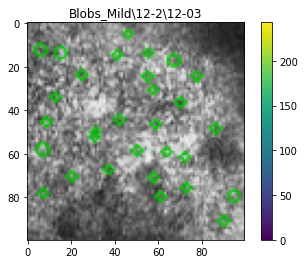

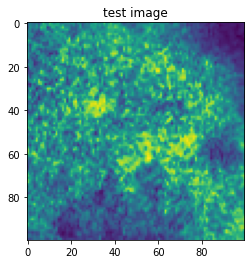

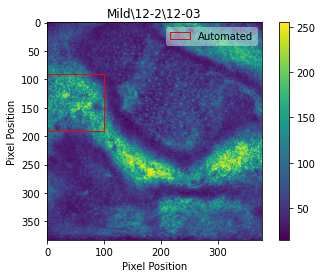

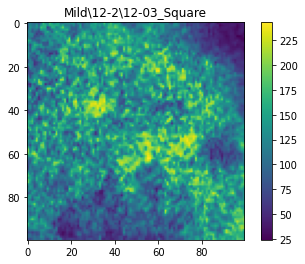

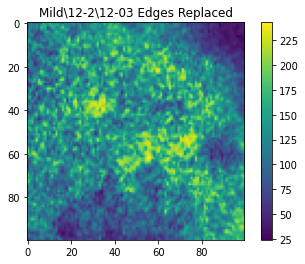

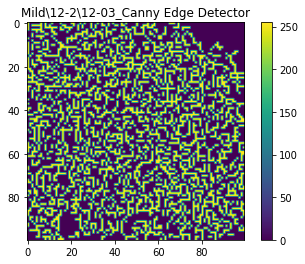

74-2-18.jpg
ifile =  Mild 74-2 74-2-18.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (390, 376)
max sharpness is  74-2-18.jpg 14.843180536444933 220 210
Percentage overlap is  34.48721260656161
Manual Area sharpness =  22.931169232226715


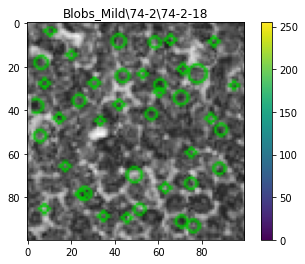

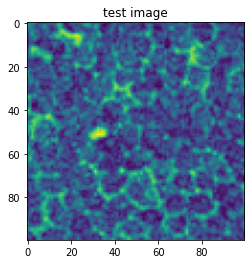

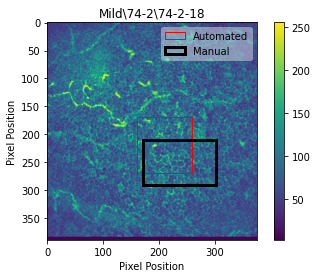

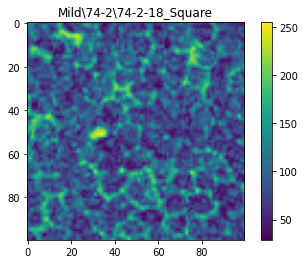

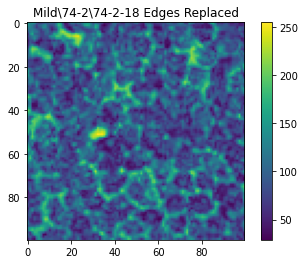

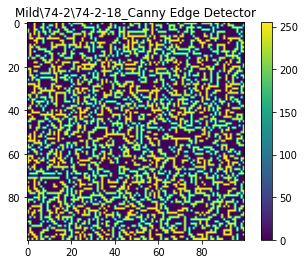

74-2-17.jpg
ifile =  Mild 74-2 74-2-17.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (387, 373)
max sharpness is  74-2-17.jpg 13.717844722791463 210 160
Percentage overlap is  3.272801887760336
Manual Area sharpness =  21.517198983379878


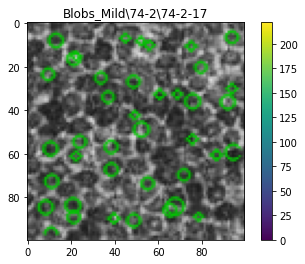

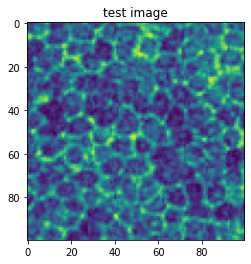

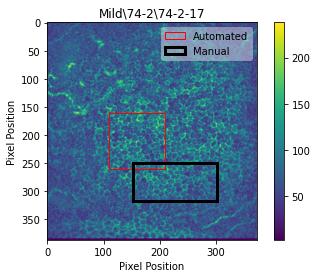

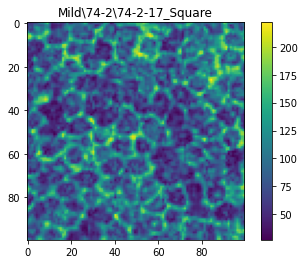

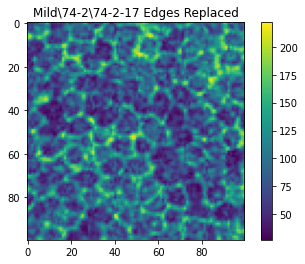

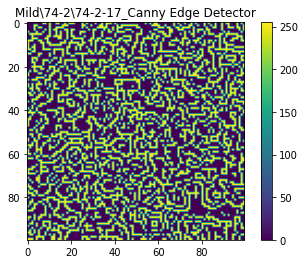

74-1-28.jpg
ifile =  Mild 74-1 74-1-28.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (382, 381)
max sharpness is  74-1-28.jpg 7.806833332094313 160 150
Percentage overlap is  58.27505827505828
Manual Area sharpness =  9.870075679631674


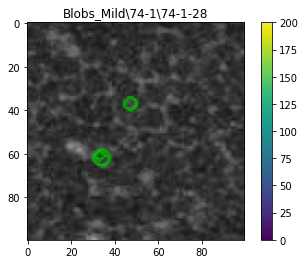

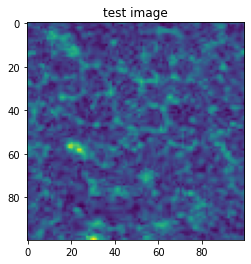

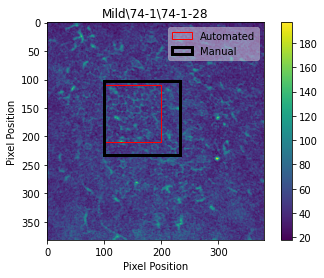

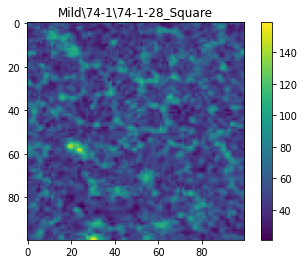

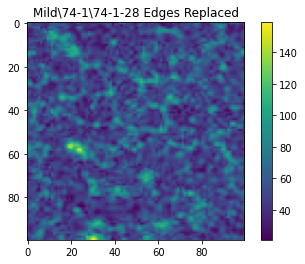

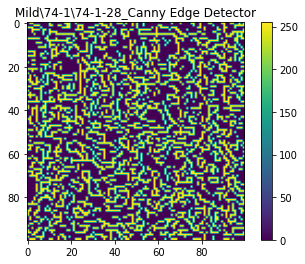

65-1-36.jpg
ifile =  Mild 65-1 65-1-36.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (387, 379)
max sharpness is  65-1-36.jpg 16.92279468131229 210 280
Percentage overlap is  44.239087691702714
Manual Area sharpness =  20.521105692005964


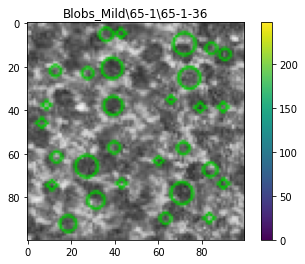

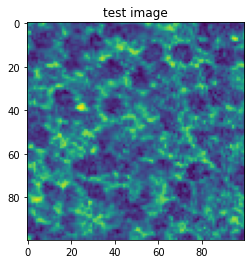

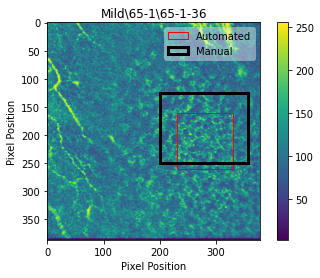

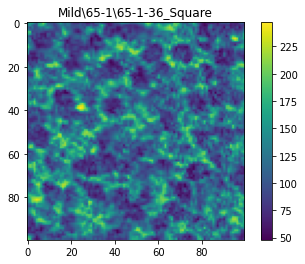

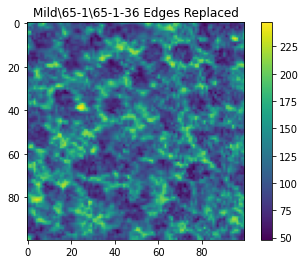

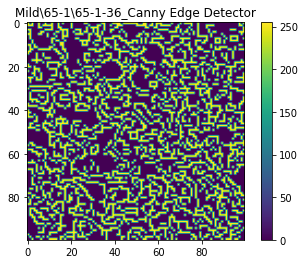

65-1-37.jpg
ifile =  Mild 65-1 65-1-37.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (383, 378)
max sharpness is  65-1-37.jpg 16.612862156166457 260 50
Percentage overlap is  0.0
Manual Area sharpness =  19.487088521092378


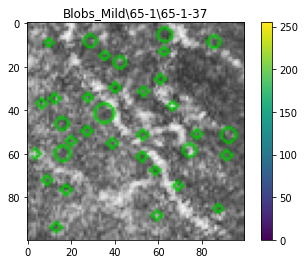

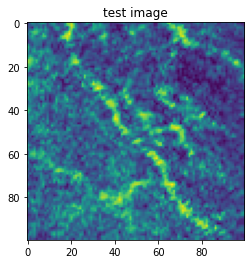

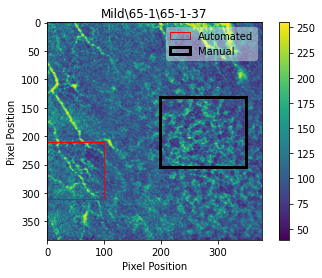

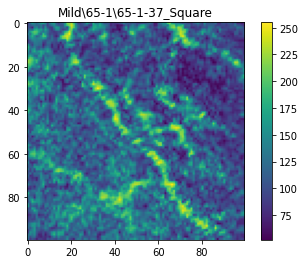

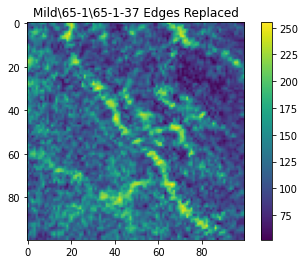

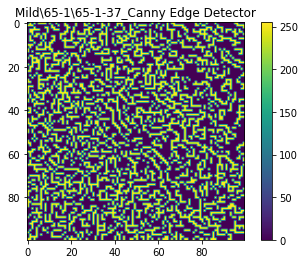

12-0-34.jpg
ifile =  Mild 12-0 12-0-34.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (395, 369)
max sharpness is  12-0-34.jpg 10.565818396674432 210 120
Percentage overlap is  0.0
Manual Area sharpness =  11.168061151282721


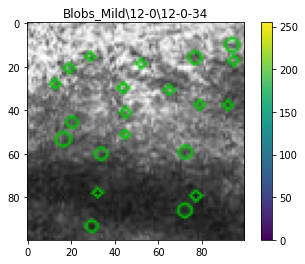

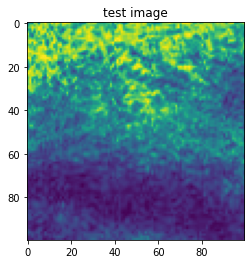

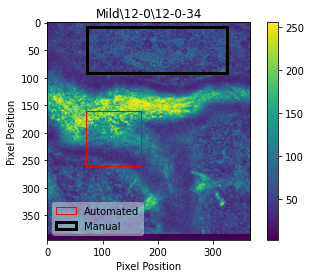

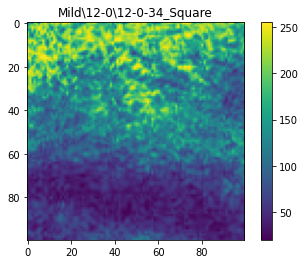

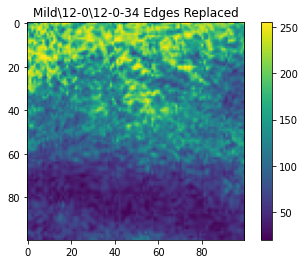

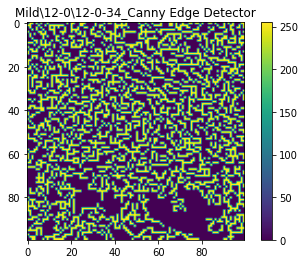

12-1-24.jpg
ifile =  Mild 12-1 12-1-24.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (389, 378)
max sharpness is  12-1-24.jpg 8.08128539053149 230 190
Percentage overlap is  18.21428571428571
Manual Area sharpness =  12.497413726794901


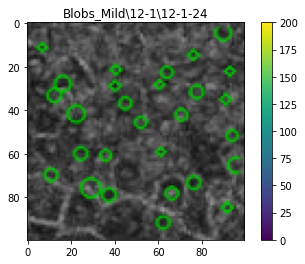

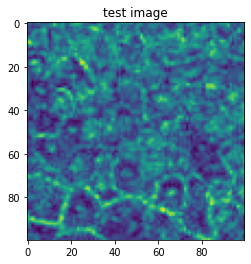

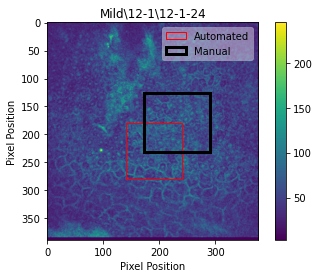

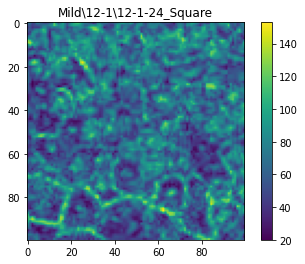

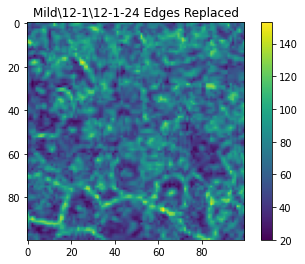

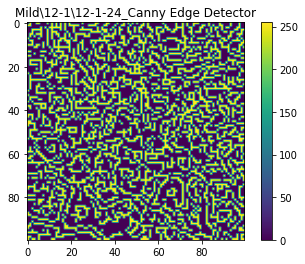

50-53-33.jpg
ifile =  Mild 50-53 50-53-33.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (380, 373)
max sharpness is  50-53-33.jpg 10.4316125662842 180 160
Percentage overlap is  27.406816822802472
Manual Area sharpness =  15.74049785711664


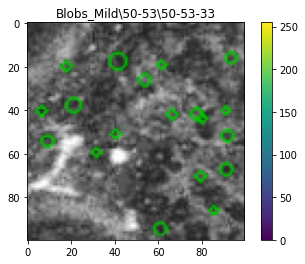

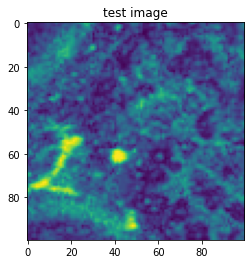

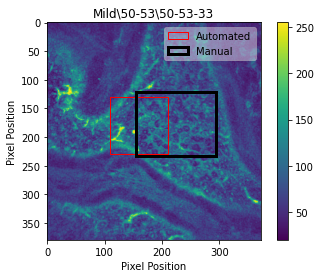

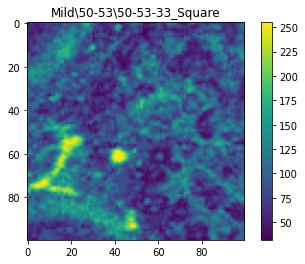

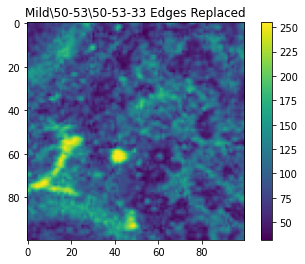

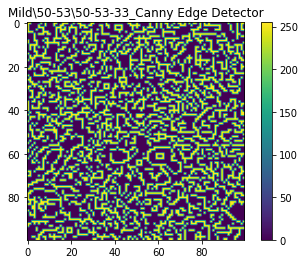

50-53-32.jpg
ifile =  Mild 50-53 50-53-32.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (382, 377)
max sharpness is  50-53-32.jpg 9.544240355131876 180 180
Percentage overlap is  0.028078056998455708
Manual Area sharpness =  14.026655972664267


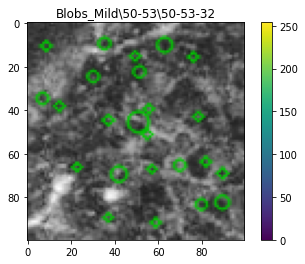

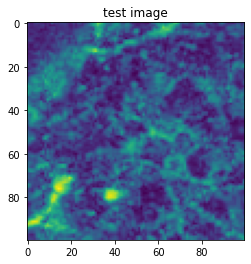

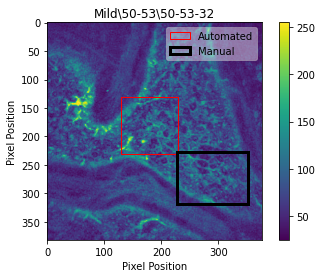

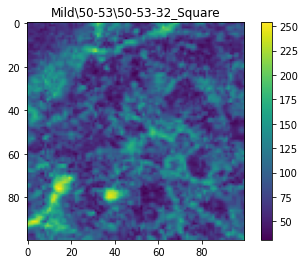

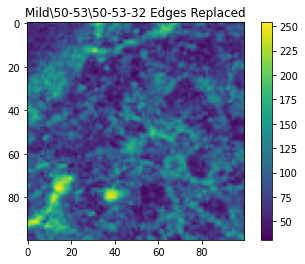

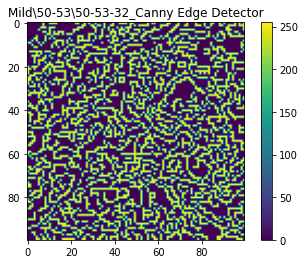

65-2-15.jpg
ifile =  Mild 65-2 65-2-15.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (388, 378)
max sharpness is  65-2-15.jpg 16.034069430267472 250 200
Percentage overlap is  14.201593349497749
Manual Area sharpness =  20.981448515970555


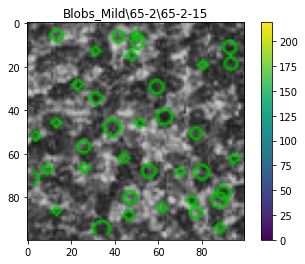

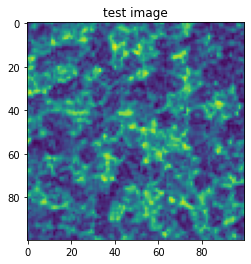

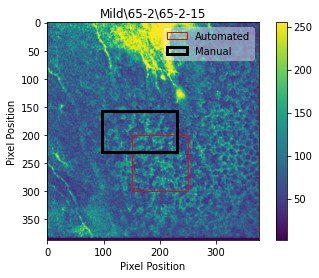

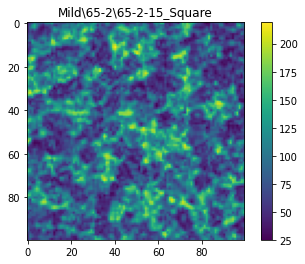

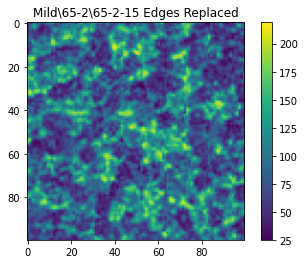

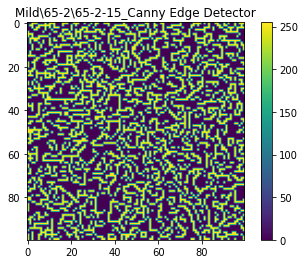

50-54-25.jpg
ifile =  Mild 50-54 50-54-25.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (387, 378)
max sharpness is  50-54-25.jpg 13.666010723942021 260 130
Percentage overlap is  0.0
Manual Area sharpness =  15.291608271311357


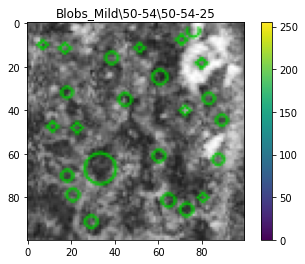

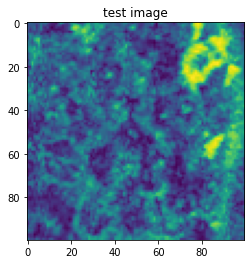

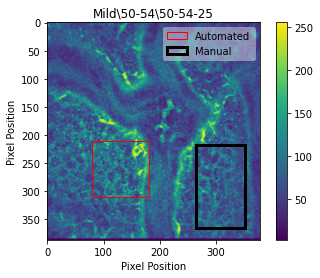

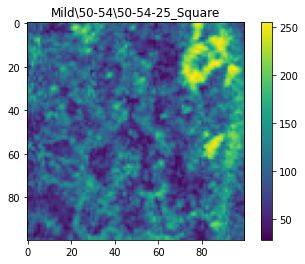

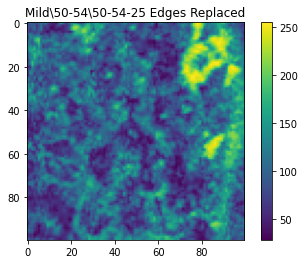

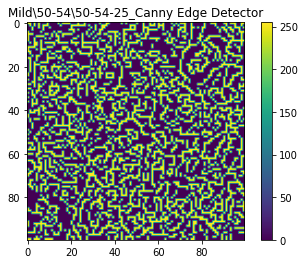

14-6-18.jpg
ifile =  Severe 14-6 14-6-18.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (389, 378)
max sharpness is  14-6-18.jpg 3.2353828025011806 180 170
Percentage overlap is  30.952380952380953
Manual Area sharpness =  5.243837677841855


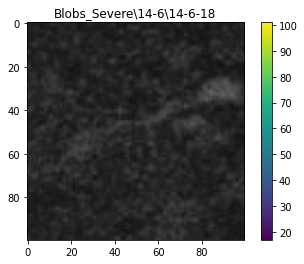

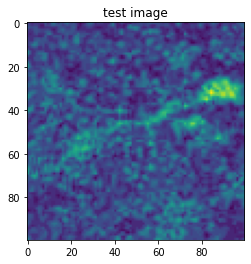

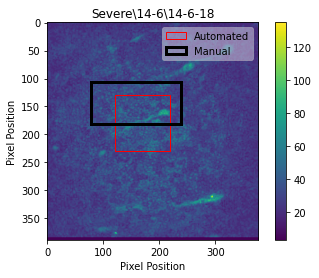

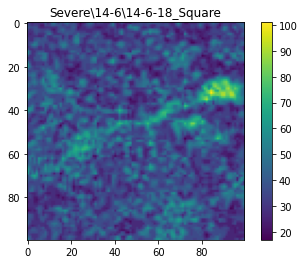

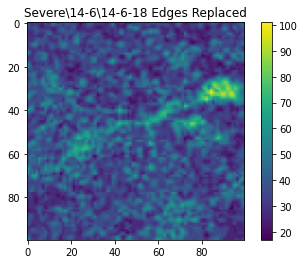

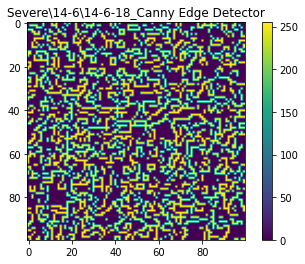

14-6-23.jpg
ifile =  Severe 14-6 14-6-23.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (390, 377)
max sharpness is  14-6-23.jpg 4.714690464993384 170 180
Percentage overlap is  0.0
Manual Area sharpness =  6.4255422791395445


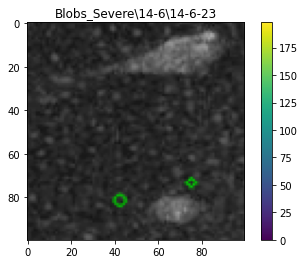

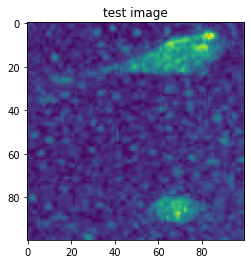

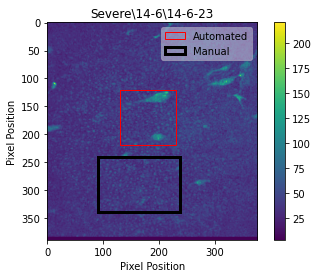

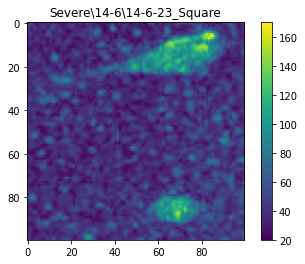

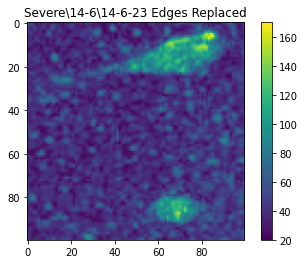

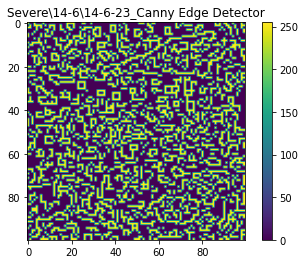

87-38-35.jpg
ifile =  Severe 87-38 87-38-35.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (384, 384)
max sharpness is  87-38-35.jpg 16.888667859976845 230 170
Percentage overlap is  0.0
Manual Area sharpness =  20.855834181102317


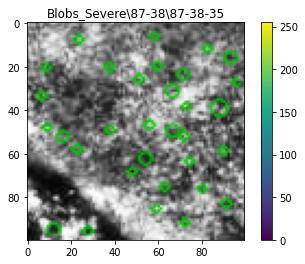

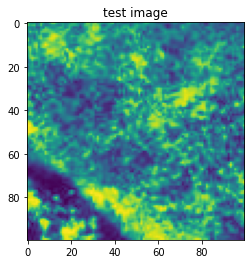

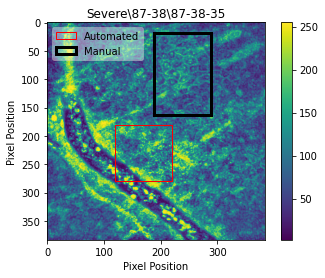

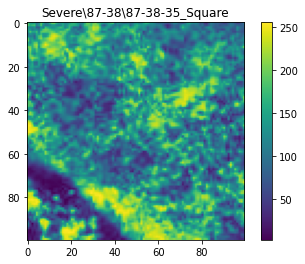

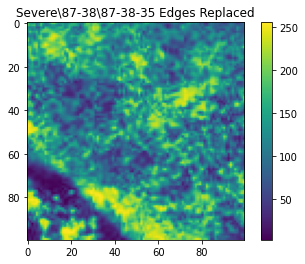

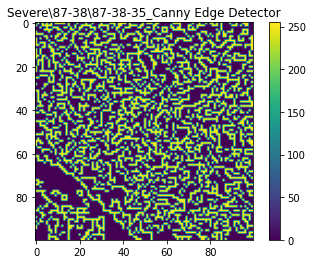

39-12-28.jpg
ifile =  Severe 39-12 39-12-28.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (385, 376)
max sharpness is  39-12-28.jpg 3.5514275928281145 140 250
Percentage overlap is  0.0
Manual Area sharpness =  11.556344687547234


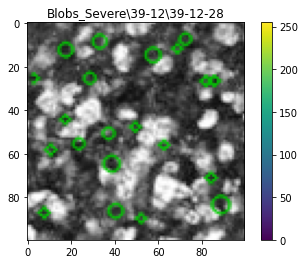

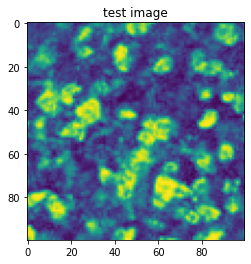

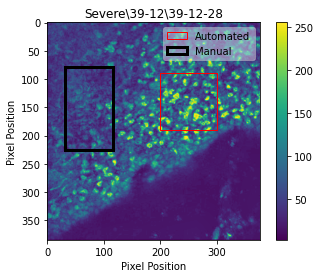

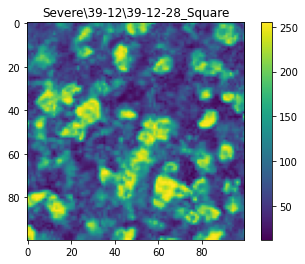

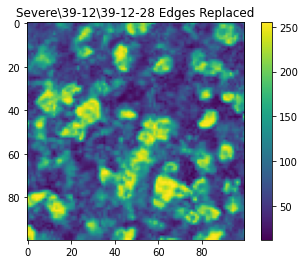

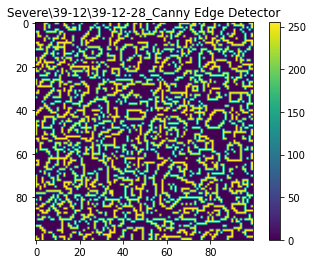

14-5-20.jpg
ifile =  Severe 14-5 14-5-20.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (388, 379)
max sharpness is  14-5-20.jpg 7.5957633897301156 180 160
FAILURE FINDING TABLE ROW:  14-5-20.jpg
MISSING USER DEFINED BOX DATA


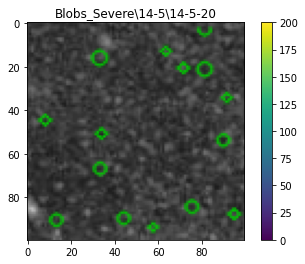

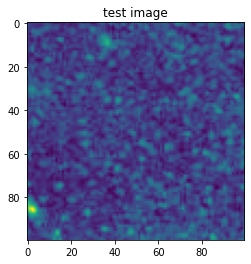

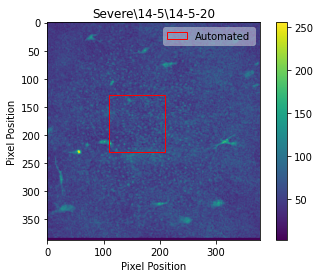

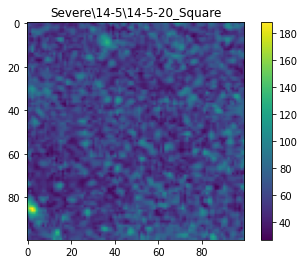

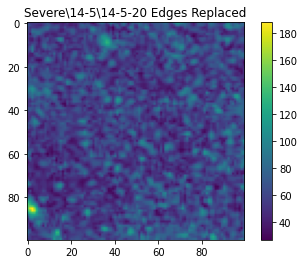

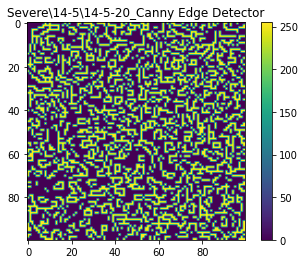

87-2-22.jpg
ifile =  Severe 87-2 87-2-22.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (383, 378)
max sharpness is  87-2-22.jpg 15.428262326057776 170 130
Percentage overlap is  11.804019390972844
Manual Area sharpness =  25.603634626630363


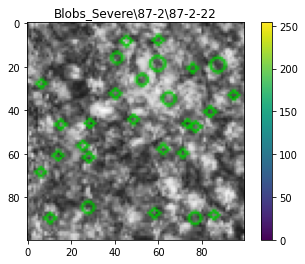

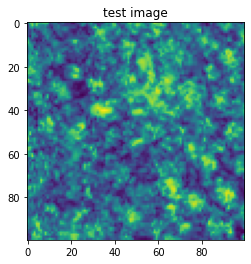

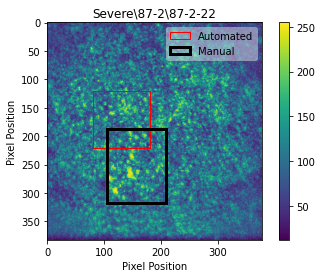

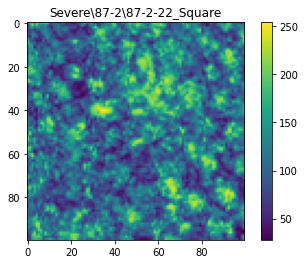

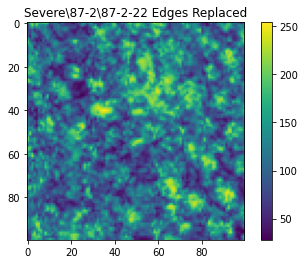

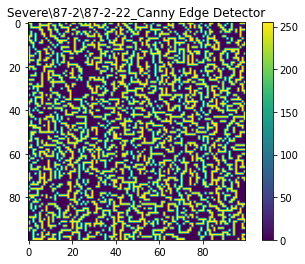

39-13-22.jpg
ifile =  Severe 39-13 39-13-22.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (384, 384)
max sharpness is  39-13-22.jpg 12.210129955241756 120 250
Percentage overlap is  0.0
Manual Area sharpness =  18.268670839113025


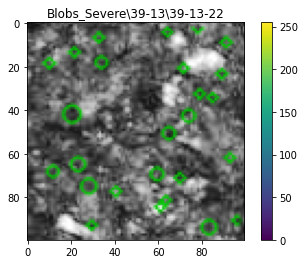

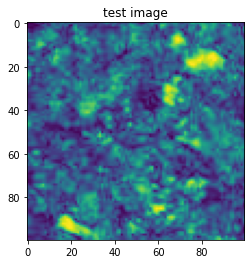

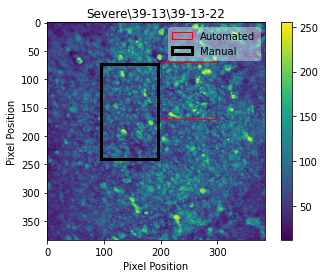

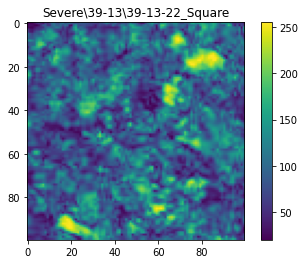

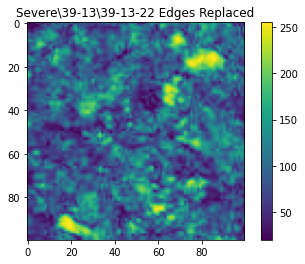

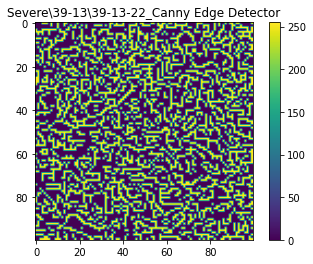

39-13-24.jpg
ifile =  Severe 39-13 39-13-24.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (384, 384)
max sharpness is  39-13-24.jpg 15.226038069660298 280 250
Percentage overlap is  0.0
Manual Area sharpness =  14.431234236922611


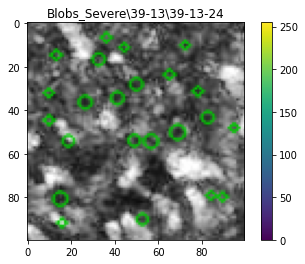

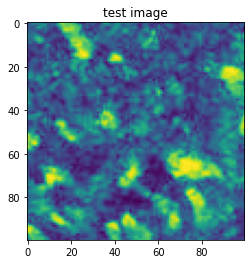

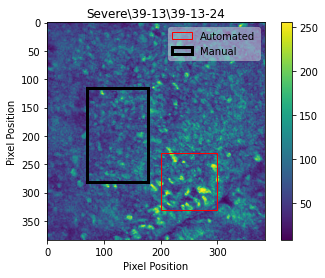

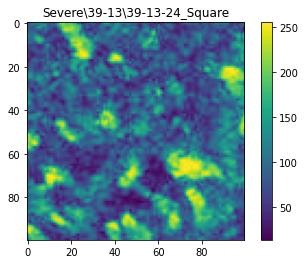

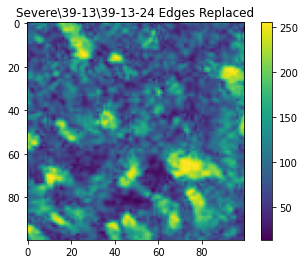

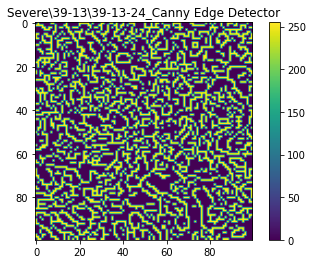

87-3-64.jpg
ifile =  Severe 87-3 87-3-64.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (389, 378)
max sharpness is  87-3-64.jpg 12.151480193016427 170 110
Percentage overlap is  5.621551766986431
Manual Area sharpness =  17.39602150126831


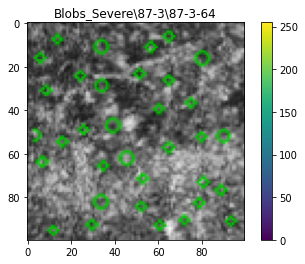

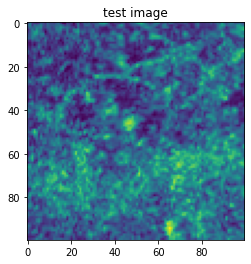

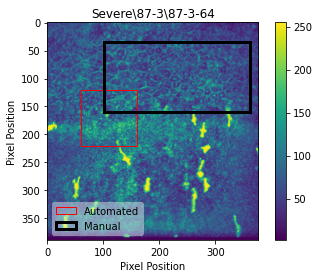

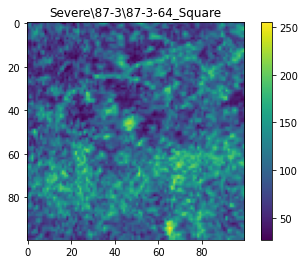

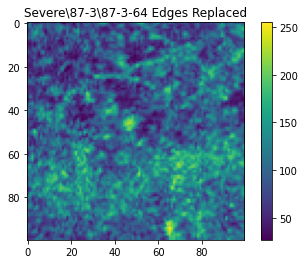

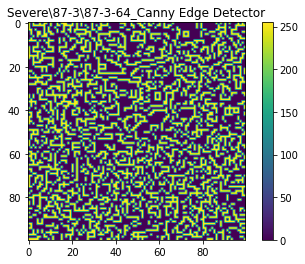

87-37.jpg
ifile =  Severe 87-37 87-37.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (387, 379)
max sharpness is  87-37.jpg 16.59470803830938 150 60
Percentage overlap is  0.0
Manual Area sharpness =  19.983405158406782


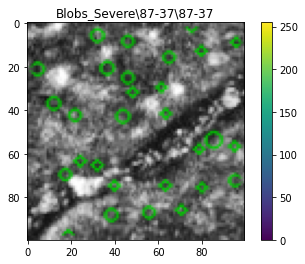

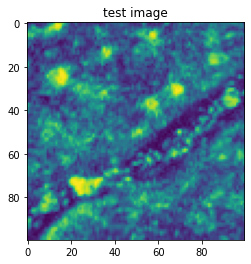

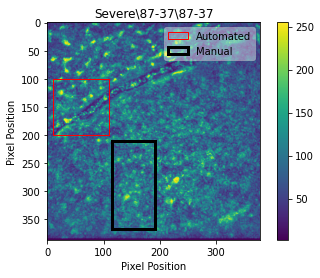

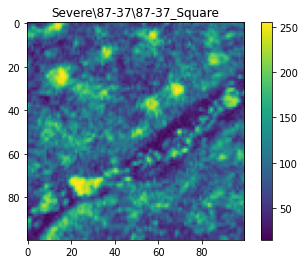

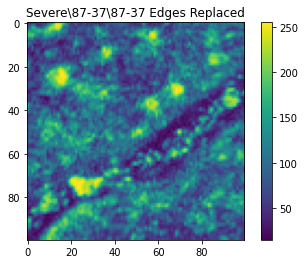

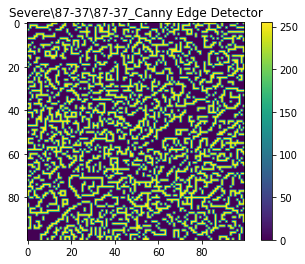

50-9-18.jpg
ifile =  Moderate 50-9 50-9-18.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (377, 376)
max sharpness is  50-9-18.jpg 16.311807591728382 200 220
Percentage overlap is  38.02281368821293
Manual Area sharpness =  27.35805363350418


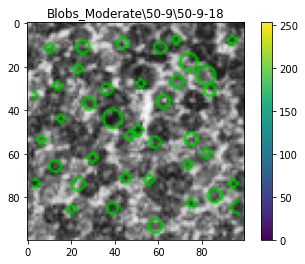

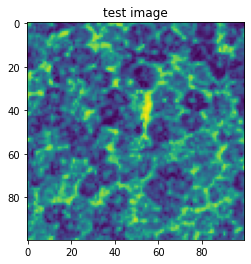

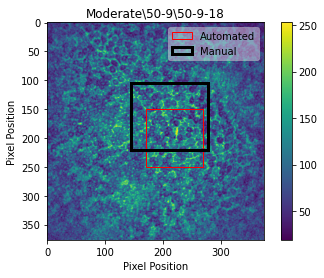

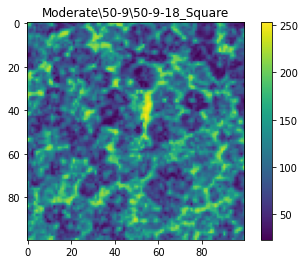

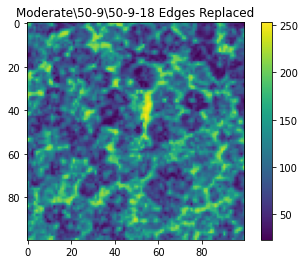

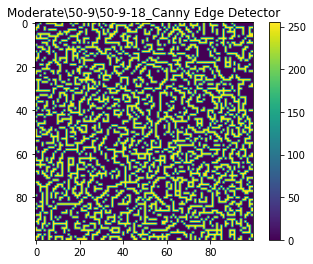

50--9-21.jpg
ifile =  Moderate 50-9 50--9-21.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (384, 379)
max sharpness is  50--9-21.jpg 20.112807561261842 170 210
FAILURE FINDING TABLE ROW:  50--9-21.jpg
MISSING USER DEFINED BOX DATA


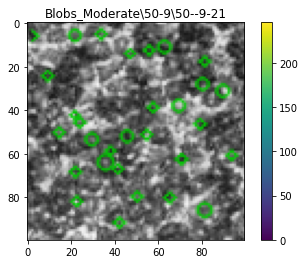

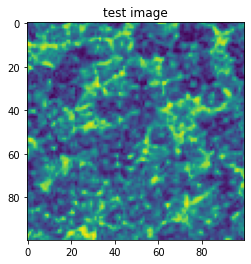

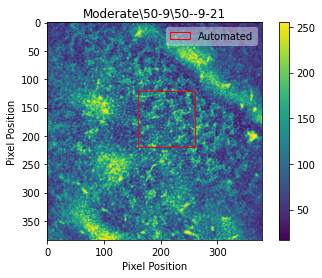

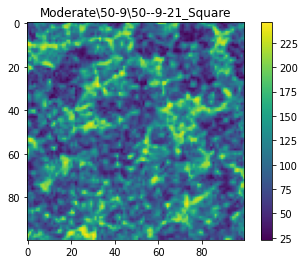

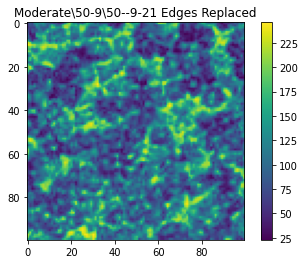

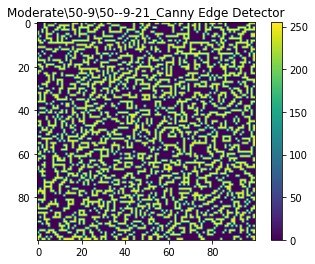

50-9-19.jpg
ifile =  Moderate 50-9 50-9-19.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (383, 378)
max sharpness is  50-9-19.jpg 18.21472783892305 180 220
Percentage overlap is  10.255018990775909
Manual Area sharpness =  26.574316104503797


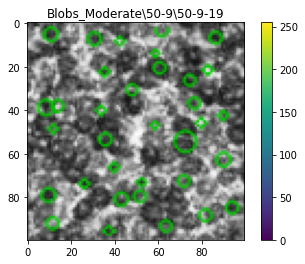

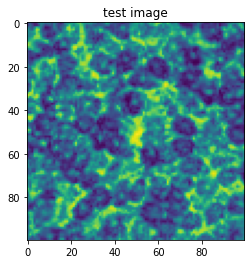

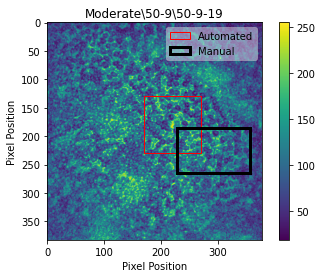

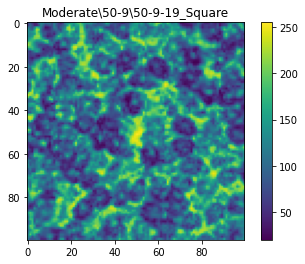

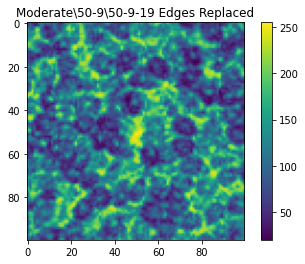

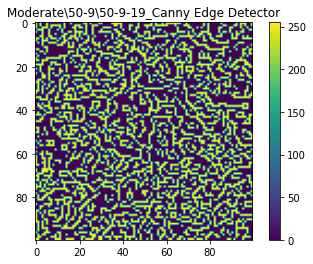

76-7-26.jpg
ifile =  Moderate 76-7 76-7-26.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (385, 376)
max sharpness is  76-7-26.jpg 12.719849412217204 280 170
Percentage overlap is  32.5497287522604
Manual Area sharpness =  17.031624336481848


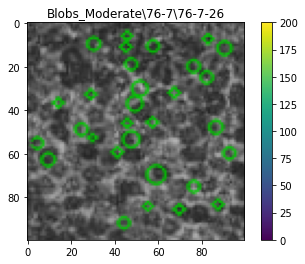

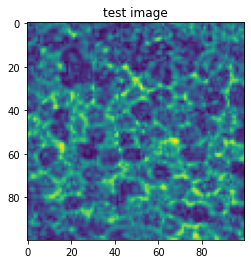

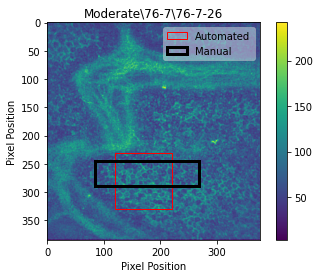

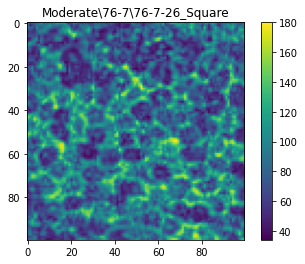

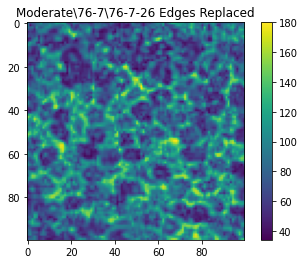

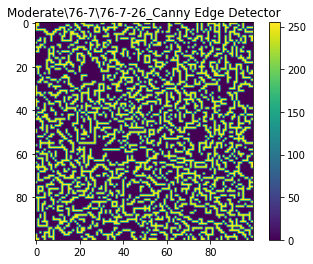

76-7-32.jpg
ifile =  Moderate 76-7 76-7-32.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (390, 376)
max sharpness is  76-7-32.jpg 14.7431946289383 190 270
Percentage overlap is  0.0
Manual Area sharpness =  18.345806382627362


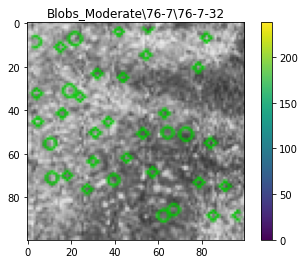

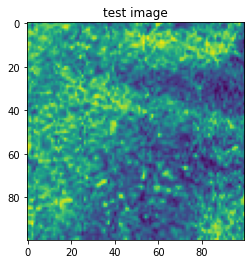

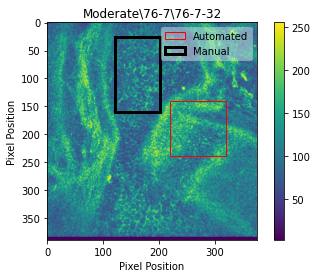

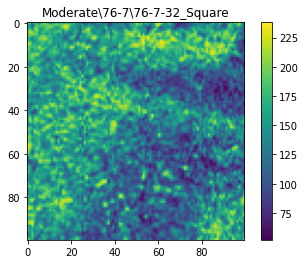

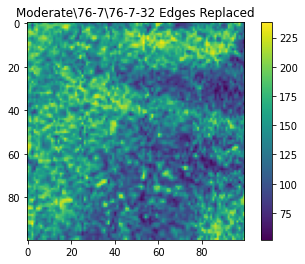

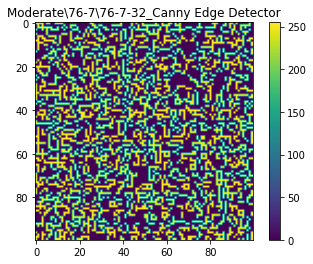

4-1-23.jpg
ifile =  Moderate 4-1 4-1-23.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (383, 377)
max sharpness is  4-1-23.jpg 12.83841806030224 230 260
Percentage overlap is  11.735073365339103
Manual Area sharpness =  13.484755695423416


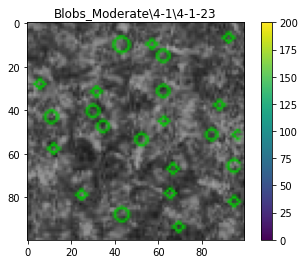

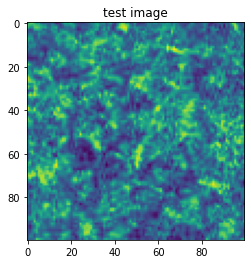

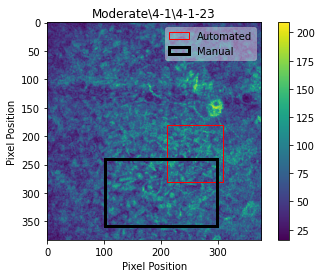

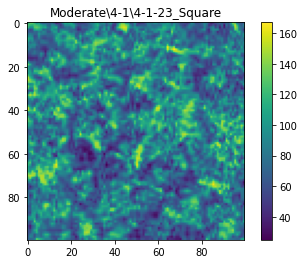

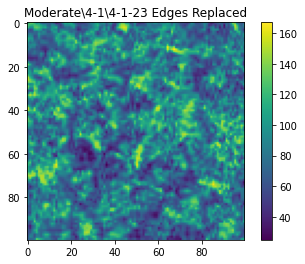

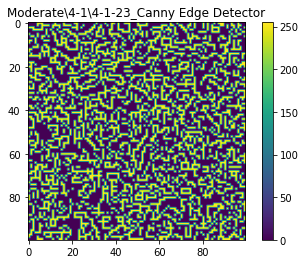

4-1-24.jpg
ifile =  Moderate 4-1 4-1-24.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (388, 379)
max sharpness is  4-1-24.jpg 14.048910669061446 240 280
Percentage overlap is  10.070976405140994
Manual Area sharpness =  14.48308562629882


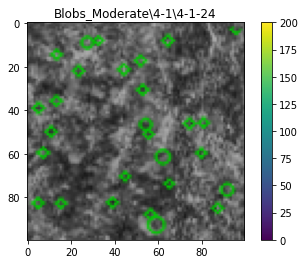

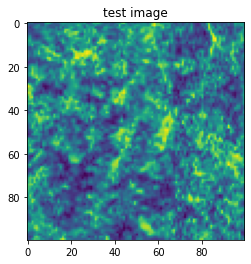

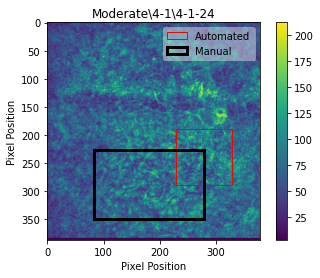

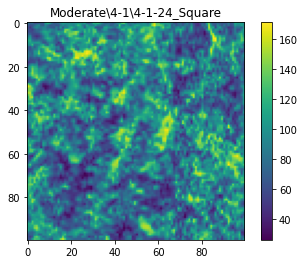

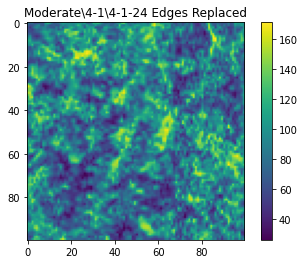

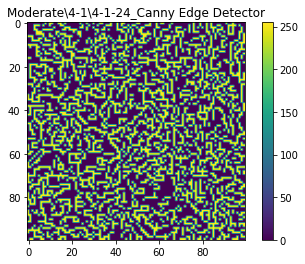

4-1-22.jpg
ifile =  Moderate 4-1 4-1-22.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (387, 379)
max sharpness is  4-1-22.jpg 10.313979347532909 220 240
Percentage overlap is  3.4956997344536487
Manual Area sharpness =  11.559669230881168


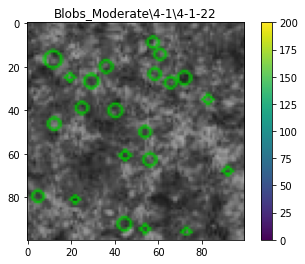

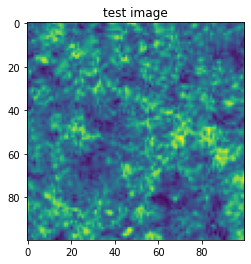

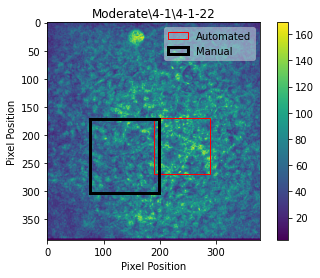

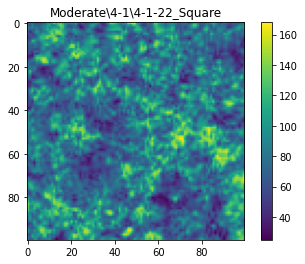

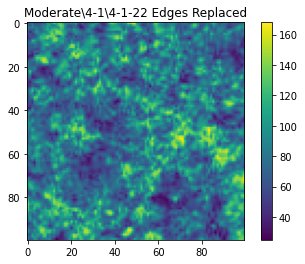

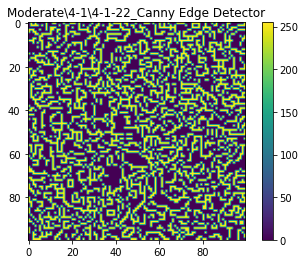

4-18-19.jpg
ifile =  Moderate 4-18 4-18-19.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (383, 376)
max sharpness is  4-18-19.jpg 11.083137788317636 220 240
Percentage overlap is  18.143236074270558
Manual Area sharpness =  14.506366398303971


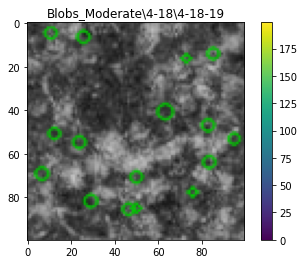

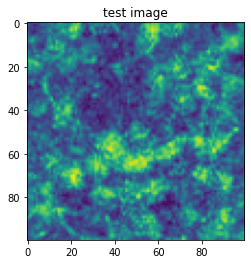

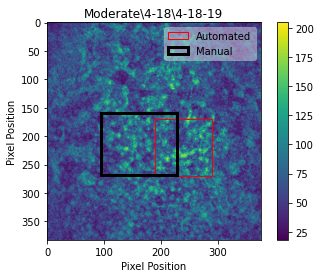

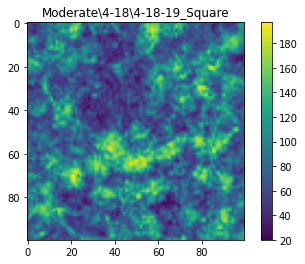

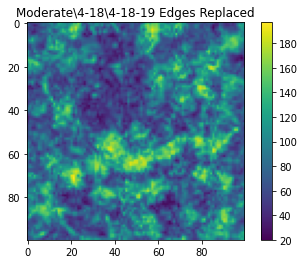

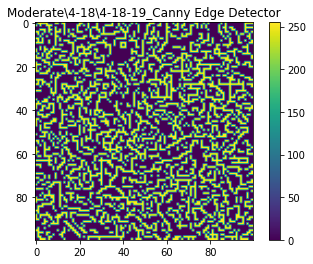

4-18-21.jpg
ifile =  Moderate 4-18 4-18-21.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (387, 378)
max sharpness is  4-18-21.jpg 14.824484440720177 50 210
Percentage overlap is  0.0
Manual Area sharpness =  16.89822615066477


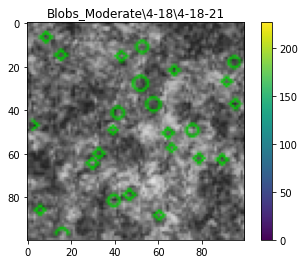

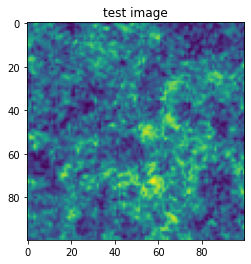

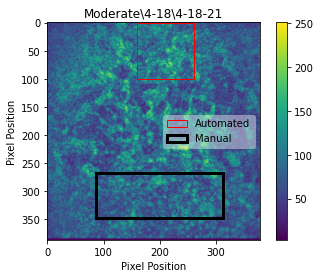

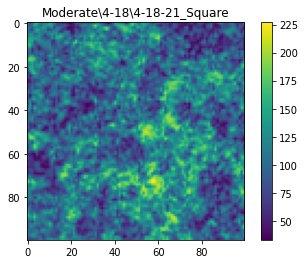

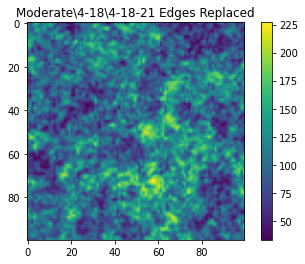

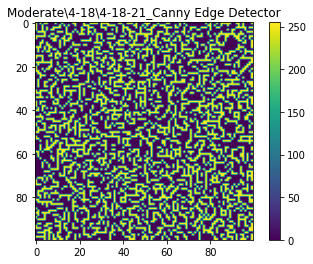

4-18-22.jpg
ifile =  Moderate 4-18 4-18-22.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (391, 377)
max sharpness is  4-18-22.jpg 16.961880262312324 70 180
Percentage overlap is  0.0
Manual Area sharpness =  18.726162615944986


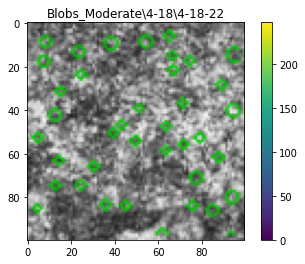

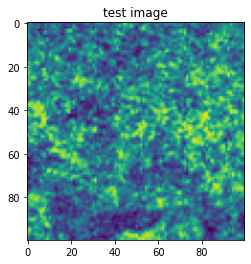

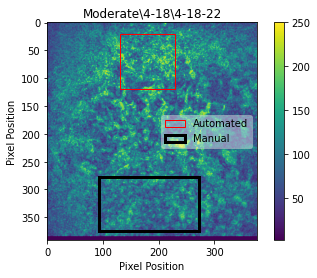

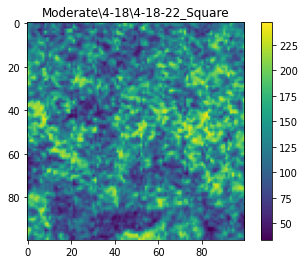

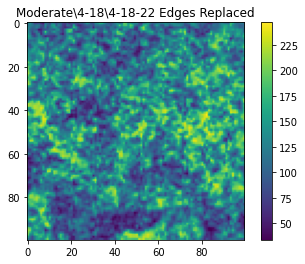

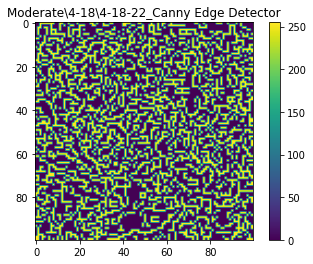

76-8-27.jpg
ifile =  Moderate 76-8 76-8-27.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (383, 379)
max sharpness is  76-8-27.jpg 15.94056784942876 210 190
Percentage overlap is  54.86968449931413
Manual Area sharpness =  21.362304067900485


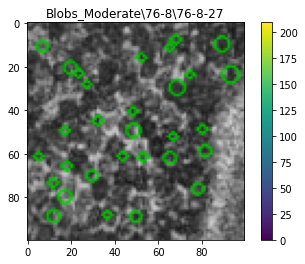

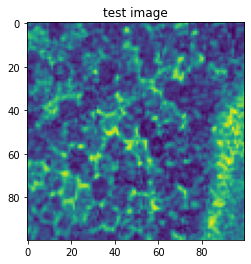

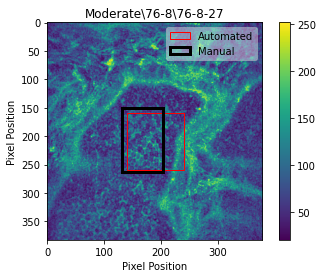

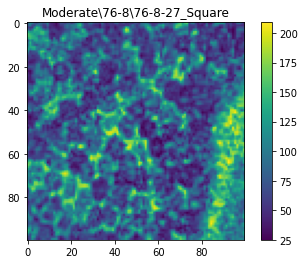

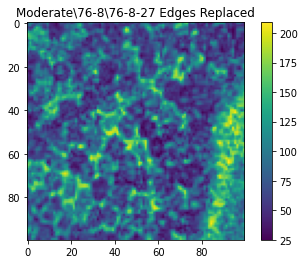

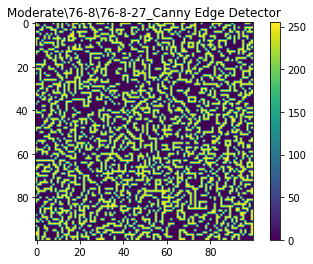

N2-na-od-6-21.jpg
ifile =  Control N2-6 N2-na-od-6-21.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (385, 379)
max sharpness is  N2-na-od-6-21.jpg 7.823264478725329 240 210
Percentage overlap is  38.64550737594993
Manual Area sharpness =  14.293835956941257


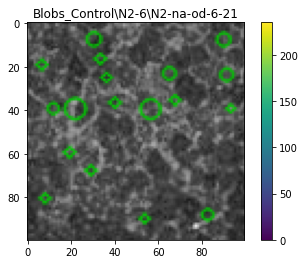

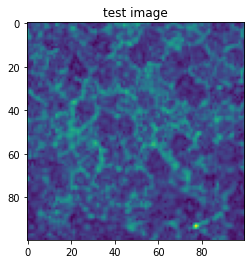

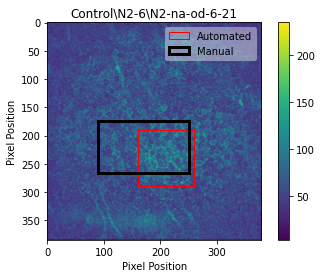

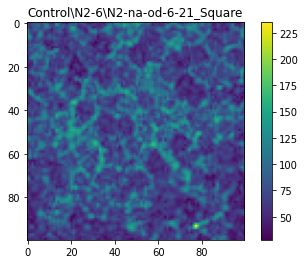

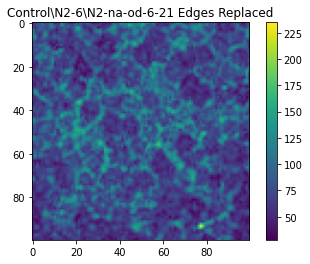

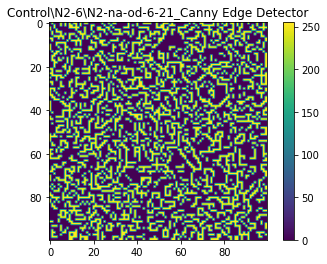

N2-na-od-0-25.jpg
ifile =  Control N2-0 N2-na-od-0-25.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (393, 372)
max sharpness is  N2-na-od-0-25.jpg 4.333252822832185 200 230
Percentage overlap is  41.08897742363878
Manual Area sharpness =  8.13564332561978


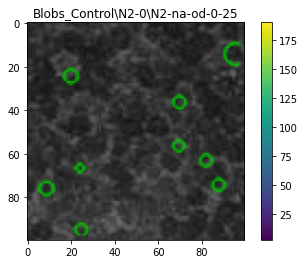

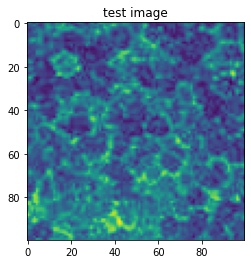

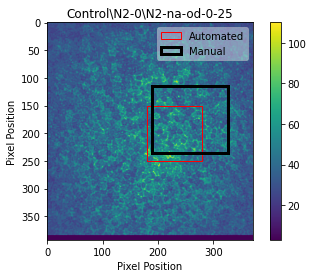

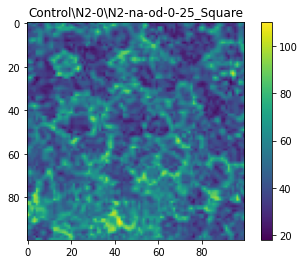

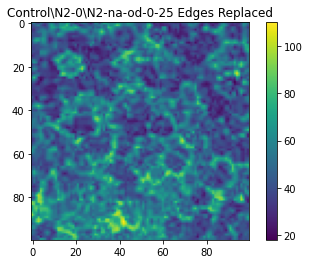

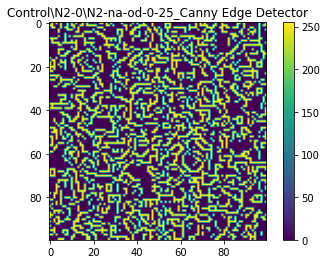

N2-na-od-0-26.jpg
ifile =  Control N2-0 N2-na-od-0-26.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (389, 379)
max sharpness is  N2-na-od-0-26.jpg 5.3735081365744595 180 220
Percentage overlap is  23.626373626373624
Manual Area sharpness =  8.717207541518473


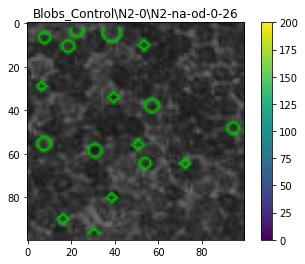

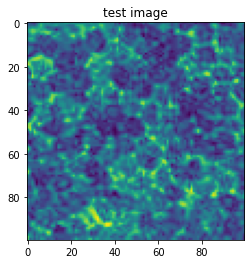

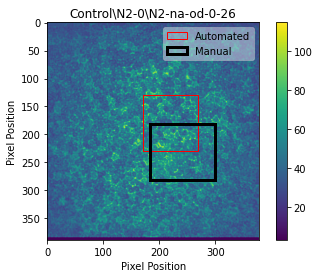

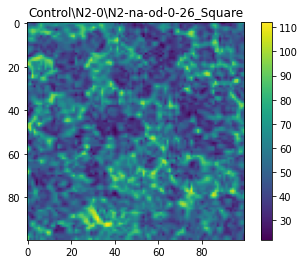

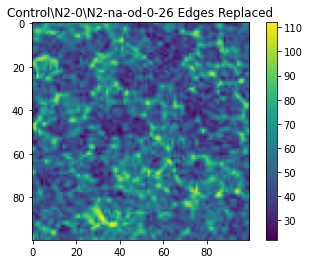

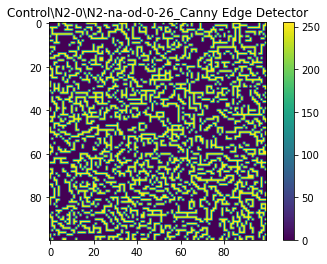

N1-1.jpg
ifile =  Control N1-1 N1-1.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (578, 576)
max sharpness is  N1-1.jpg 4.594243118412938 260 50
Percentage overlap is  0.0
Manual Area sharpness =  6.723107804553102


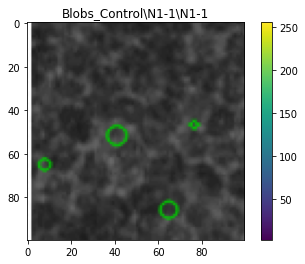

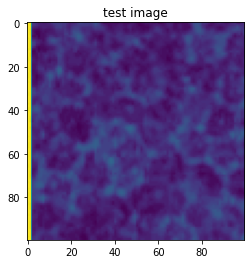

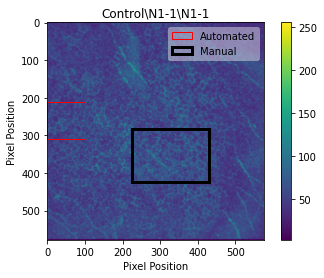

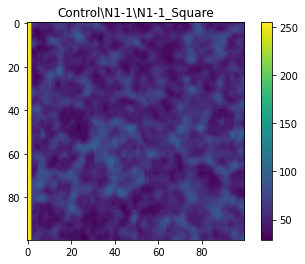

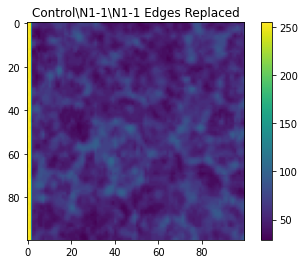

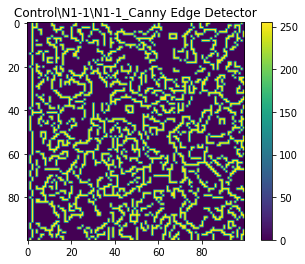

N3-2-32.jpg
ifile =  Control N3-2 N3-2-32.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (386, 379)
max sharpness is  N3-2-32.jpg 10.14940252292267 300 170
Percentage overlap is  55.07145346810736
Manual Area sharpness =  12.49930533425565


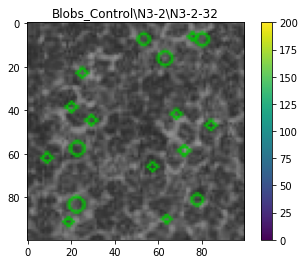

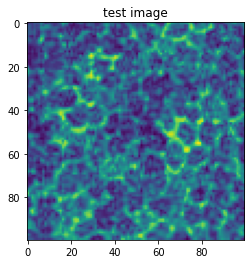

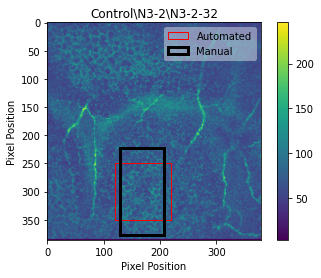

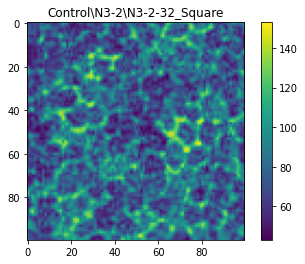

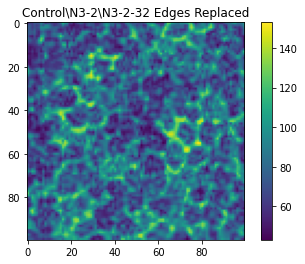

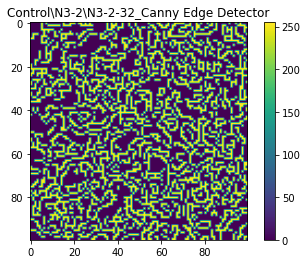

N3-1-30.jpg
ifile =  Control N3-1 N3-1-30.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (386, 379)
max sharpness is  N3-1-30.jpg 12.384127613040722 240 240
Percentage overlap is  44.53859105969257
Manual Area sharpness =  14.737487867844369


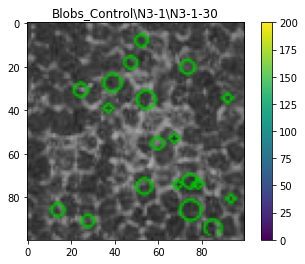

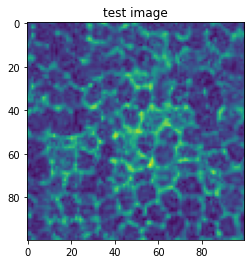

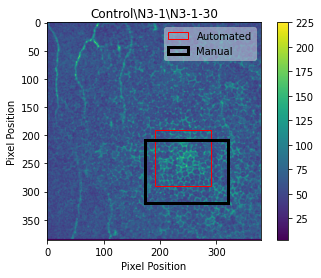

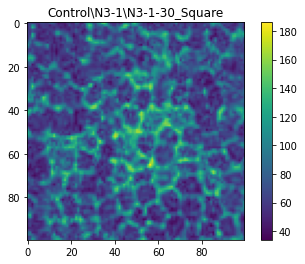

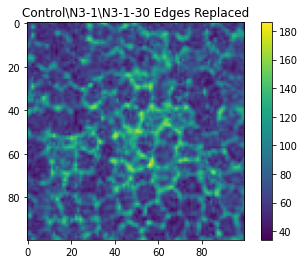

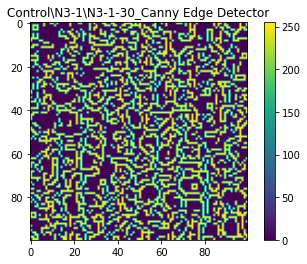

N3-1-31.jpg
ifile =  Control N3-1 N3-1-31.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (385, 379)
max sharpness is  N3-1-31.jpg 12.138007699914725 240 280
Percentage overlap is  8.794197642792383
Manual Area sharpness =  14.82776753984455


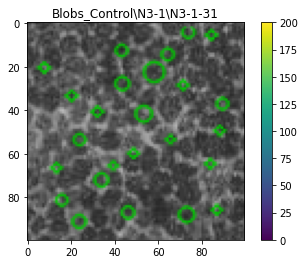

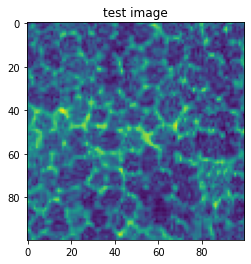

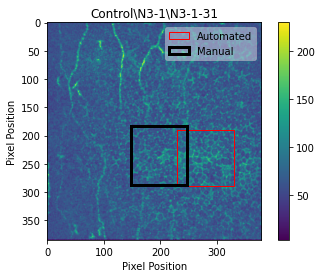

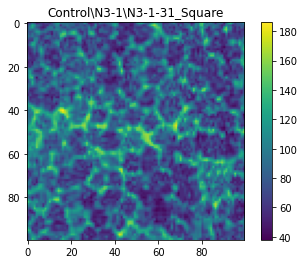

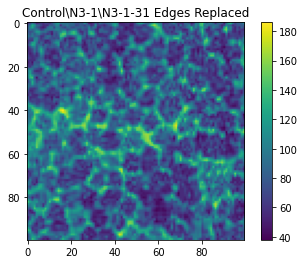

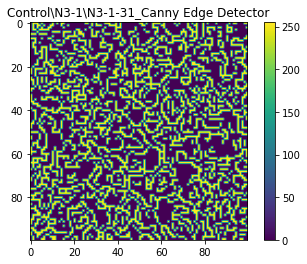

N1-2-30.jpg
ifile =  Control N1-2 N1-2-30.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (580, 572)
max sharpness is  N1-2-30.jpg 3.7257738164420187 370 380
Percentage overlap is  0.0
Manual Area sharpness =  7.4450530725734065


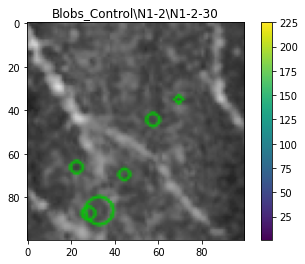

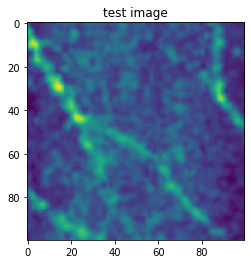

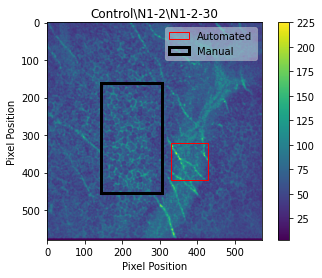

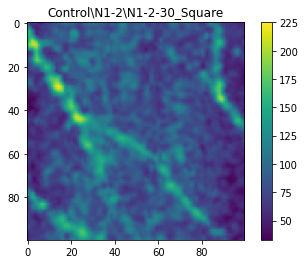

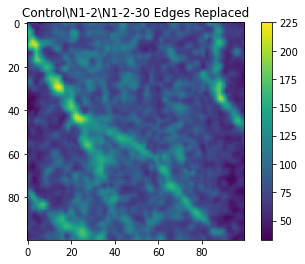

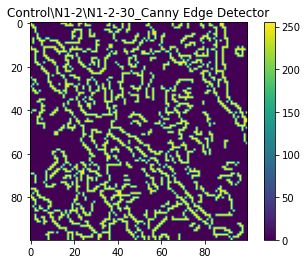

N1-2-31.jpg
ifile =  Control N1-2 N1-2-31.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (578, 574)
max sharpness is  N1-2-31.jpg 4.418273027416853 370 340
Percentage overlap is  0.0
Manual Area sharpness =  8.675259965127275


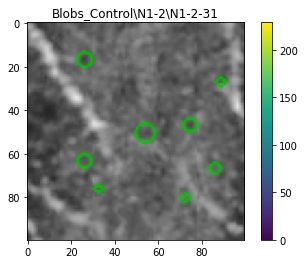

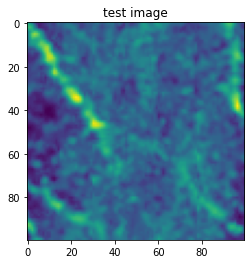

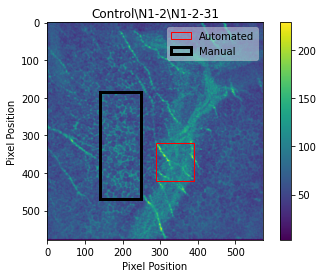

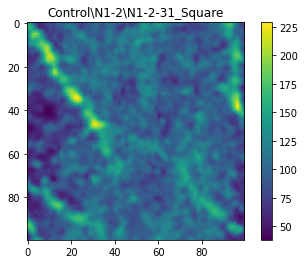

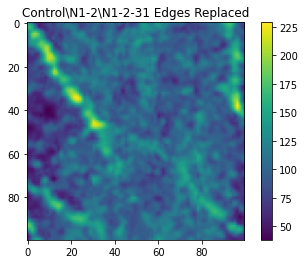

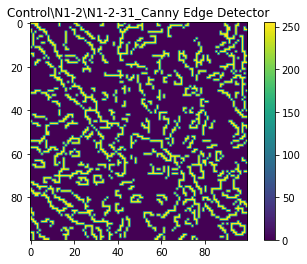

N1-47-23.jpg
ifile =  Control N1-47 N1-47-23.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (384, 384)
max sharpness is  N1-47-23.jpg 11.285068764750301 290 200
FAILURE FINDING TABLE ROW:  N1-47-23.jpg
MISSING USER DEFINED BOX DATA


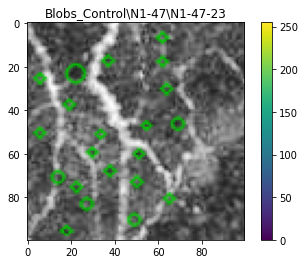

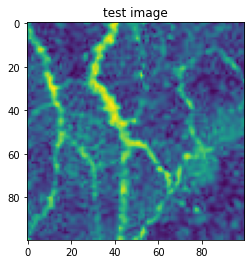

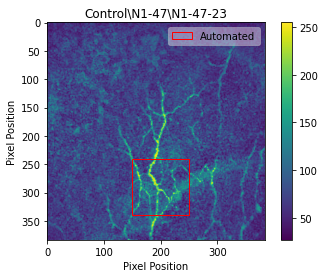

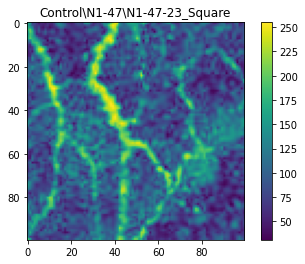

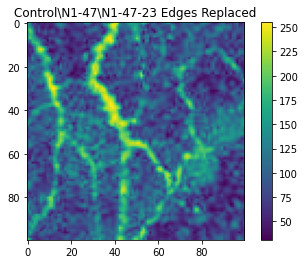

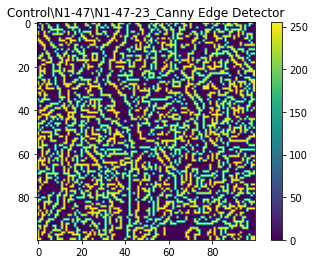

N1-46-16.jpg
ifile =  Control N1-46 N1-46-16.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (384, 379)
max sharpness is  N1-46-16.jpg 16.23445697089056 180 110
Percentage overlap is  57.01615457713019
Manual Area sharpness =  30.84033789523592


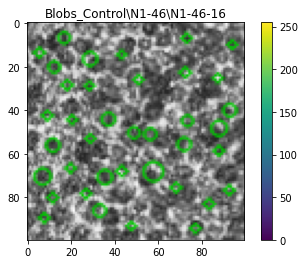

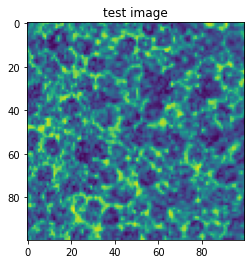

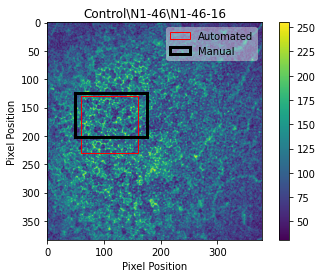

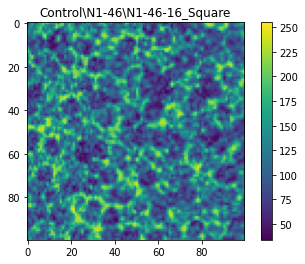

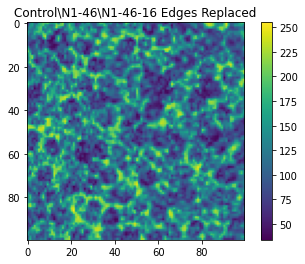

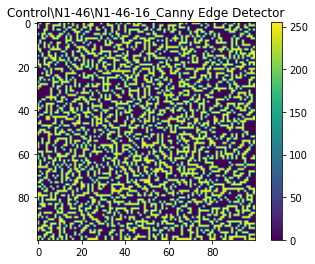

N1-46-17.jpg
ifile =  Control N1-46 N1-46-17.jpg
type is  <class 'imageio.core.util.Array'>
	shape =  (387, 379)
max sharpness is  N1-46-17.jpg 16.797261569460698 230 120
Percentage overlap is  13.580246913580247
Manual Area sharpness =  27.758364806961332


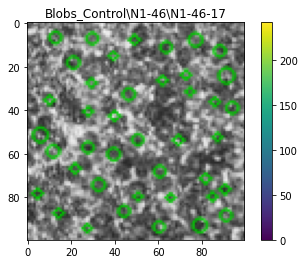

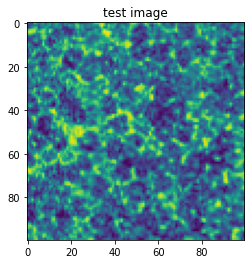

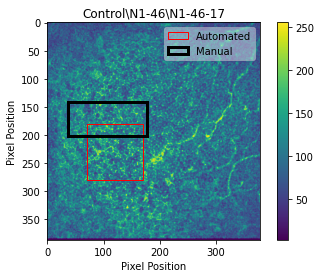

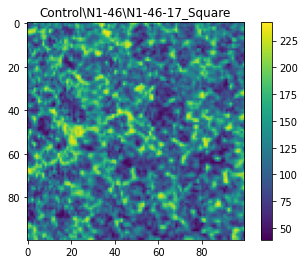

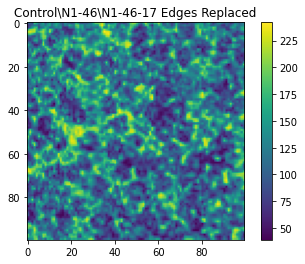

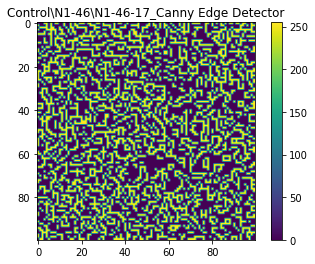

!!!!!! PATCH SELECTION COMPLETE
Saved data to pickle files


In [97]:
'''
Get patches
'''

#
# store outputs
#
output_patch = {}
output_borders ={}
sharpness_manual = {}
sharpness_auto = {}
overlap = {}

#
# Go through every folder of data and pull out raw image data
#   find nxn square that gives best sharpness value from gradients
#
for ikey in im.keys():
    for ptype in im[ikey].keys():
        for ptfolder in im[ikey][ptype].keys():
            for ifile in im[ikey][ptype][ptfolder].keys():
                print(ifile)
                imdata = im[ikey][ptype][ptfolder][ifile]
                print('ifile = ',ikey,ptfolder,ifile)

                #
                #Histogram Equalization
                #
                print('type is ', type(imdata))
                #imdata = cv2.equalizeHist(np.uint8(imdata))

                clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
                imdata = clahe.apply(np.uint8(imdata))


                if (np.size(imdata)> 0):
                    image_shape = np.shape(imdata)
                    print('\tshape = ',image_shape)
                    irow = image_shape[0]
                    icol = image_shape[1]

                    #if animating, set the file numbering for each slide
                    image_number = 0


                    box_length = 50 #length from center to one side
                    max_sharpness = 0.0 #default output value
                    max_row = 0 #default location of maximum sharpness
                    max_col = 0 #default location of maximum sharpness
                    for row in range(box_length, irow- box_length,10):
                        for col in range(box_length, icol - box_length,10):
                            square_data =get_square(imdata,row,col,box_length)
                            

                            ####################################################
                            #FWHM to get the majority of contrast values used
                            fwhm=get_fwhm(square_data,30)
                            low_contrast = fwhm[0]
                            high_contrast = fwhm[-1]
                            ####################################################


                            ####################################################
                            # check to see if vessel hijacking values
                            ####################################################

                            #get max intensity and lowest intensity over image
                            max_i = np.max(square_data) #imdata)
                            min_i = np.min(square_data) #imdata)

                            #get indices to any areas in box that exceed an 
                            #intesity threshold. This will be used to boot out 
                            #any squares that have a lot of very high intensity
                            #pixels, which can be caused by other tissue in the 
                            #view
                            high_intensity = np.argwhere(square_data >= (max_i * 0.80))
                            numels = np.size(square_data)
                            
                            if (np.size(high_intensity) >= (numels*0.2)):
                                #lots of high intensity pixels found in this
                                #print('max, min,numels is ',max_i,min_i,numels,np.size(high_intensity))
                                #print('too many High I pixels. Drop this one')
                                continue

                            #
                            #Detect thin high intensity areas in subsample
                            #
                            sq2 = square_data.copy() #temp holder

                            #get mean and max values in square. Find any edges
                            #that are within an upper range of this intensity
                            med = np.mean(sq2)
                            max2 = np.max(sq2)
                            edges = cv2.Canny(np.uint8(sq2),low_contrast, high_contrast) #max2*0.85,max2)
                            #note: edges are output in binary

                            #
                            # Flood fill the edges to remove them. Fill in with 
                            # average values
                            #
                            #flood_image = edges.copy()
                            #replace_value = med

                            #try to fill in gaps of thin lines
                            kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4, 4))
                            dilated = cv2.dilate(edges, kernel)
                            eroded=cv2.erode(dilated,kernel)
                            output_image = square_data.copy()
                            #temp_sq2 = output_image.copy()
                            index = np.argwhere(eroded > 0) #binary for edges
                            '''
                            for ivals in index:
                                #replace all edge values with medium
                                if (np.size(ivals) > 0):
                                    output_image[ivals[0],ivals[1]] = med
                                    #temp_sq2[ivals[0],ivals[1]] = med
                                else:
                                    print('No binary eroded edges')

                            '''

                            #
                            #Calculate sharpness
                            #
                            gy,gx = np.gradient(output_image)#edges avgd out
                            #gy,gx = np.gradient(square_data)

                            gnorm = np.sqrt(gx**2 + gy**2)
                            sharpness_number = np.average(gnorm)
                        
                            #
                            #If this sharpness value is greater than the prev.
                            #stored value, replace the max value. This will
                            #always contain the square with the best sharpness
                            #
                            if (sharpness_number > max_sharpness):
                                max_sharpness = sharpness_number
                                max_row = row
                                max_col = col
                                square_holder = square_data.copy()
                                edge_holder = edges.copy()
                                output_image_holder = output_image.copy()

                                low_contrast_holder = low_contrast.copy()
                                high_contrast_holder = high_contrast.copy()

                                #filename of sharpest file
                                file_indicator = ikey + '\\' + ptfolder + '\\' + ifile.split(".")[0]

                                ################################################
                                #Animate images
                                ################################################
                                if (animate_image == 1):



                                    image_number = image_number + 1
                                    image_info = os.path.splitext(ifile) #will return two parts, name and ext
                                    animated_base_name = image_info[0]
                                    #keyname = root_ext[0] #dump the extension for the key 
                                    write_frame(max_col, max_row, box_length, \
                                                imdata, animation_dir,image_number,animated_base_name)
                                ################################################


                    print('max sharpness is ',ifile, sharpness_number,max_row,max_col)
                else:
                    print('found an empty file', ptfolder, ifile)
                    continue
                
                #
                # Define box coordinates
                #
                left_wall = max_col - box_length
                right_wall = max_col + box_length
                low_wall = max_row - box_length
                high_wall = max_row + box_length



                ####################################################
                #BLOB DETECTION
                ####################################################
                im_with_keypoints = get_blobs(square_holder,low_contrast_holder,high_contrast_holder)

                plt.figure()
                plt.imshow(im_with_keypoints)
                plt.colorbar()
                tname = 'Blobs' + '_' + file_indicator
                plt.title(tname)

                plt.figure()
                plt.imshow(square_holder)
                plt.title('test image')

                ################################################################
                # Pull bounding boxes
                ################################################################
                id_number = 99
                if ifile in ordered_files:
                    #found this file in our list, get table of data
                    for table_counter,order_name in enumerate(ordered_files):
                        if (ifile == order_name):
                            id_number = table_counter
                
                user_data_found = 0
                if (id_number == 99):
                    print('FAILURE FINDING TABLE ROW: ',ifile)
                    manual_sharpness_number = 0.0
                else:
                    box_data = table_data[id_number][5:9]
                    user_right = int(box_data[0])
                    user_left = int(box_data[1])
                    user_top = int(box_data[2])
                    user_bottom = int(box_data[3])
                    user_x = user_right - user_left
                    user_y = user_top - user_bottom
                    user_data_found = 1 #allow the user patch to be created

                    ############################################################
                    # Get union of automatic and manual boxes. Check to see if 
                    #there is overlap between what the code thinks is a good 
                    #area and what the researchers chose.
                    #- There is likely to not be 100% union due to the fixed 
                    #area chosen by the automated manner and the free-form boxes
                    # that can be manually chosen.
                    ############################################################

                    #generate box coordinates for testing
                    box_2 = [[user_left,user_bottom],[user_left,user_top],[user_right,user_top],[user_right,user_bottom]]
                    box_1 = [ [left_wall,low_wall],[left_wall,high_wall],[right_wall,high_wall],[right_wall,low_wall]]

                    overlap[ifile] = calculate_ioveru(box_1, box_2)*100.0
                    print('Percentage overlap is ',overlap[ifile])

                    ################################################################
                    #Calculate sharpness of manual bounding area to compare to the
                    #automated values
                    ################################################################
                    gy,gx = np.gradient(imdata[user_bottom:user_top,user_left:user_right])#edges avgd out
                    #gy,gx = np.gradient(square_data)

                    gnorm = np.sqrt(gx**2 + gy**2)
                    manual_sharpness_number = np.average(gnorm)
                    print('Manual Area sharpness = ',manual_sharpness_number)



                #plot original image data
                plt.figure()
                plt.imshow(imdata)
                plt.title(file_indicator)
                plt.colorbar()
                plt.xlabel('Pixel Position')
                plt.ylabel('Pixel Position')

                #define square for plotting over the image
                rect = patches.Rectangle((left_wall,low_wall),box_length*2,box_length*2,linewidth=1,edgecolor='r',facecolor='none')

                # Get the current reference
                ax = plt.gca()
                # Add the patch to the Axes
                ax.add_patch(rect)

                if (user_data_found == 1):
                    #define square for original box choice
                    user_rect = patches.Rectangle((user_left, user_bottom),user_x,user_y,linewidth=3,edgecolor='black',facecolor='none')
                    ax.add_patch(user_rect)
                else:
                    print('MISSING USER DEFINED BOX DATA')

                ax.legend(['Automated','Manual'],fancybox=True, framealpha=0.4)
                plt.show()

                
                #
                #histogram
                #
                #hist, bin_edges= np.histogram(imdata)
                
                #plot square contents
                plt.figure()
                plt.imshow(square_holder)
                plt.colorbar()
                tname = file_indicator + '_Square'
                plt.title(tname)
                plt.show()

                #plot the square with edges replaced with mean values
                plt.figure()
                plt.imshow(output_image_holder)
                plt.colorbar()
                tname = file_indicator + ' Edges Replaced'
                plt.title(tname)
                plt.show()
                
                #plot edges found
                plt.figure()
                plt.imshow(edge_holder)
                plt.colorbar()
                tname = file_indicator + '_Canny Edge Detector'
                plt.title(tname)
                plt.show()


                #plot the square with edges replaced with mean values
                #plt.figure()
                #plt.imshow(temp_sq2_holder)
                #plt.colorbar()
                #tname = file_indicator + ' Flood replacement Full'
                #plt.title(tname)
                #plt.show()


                #
                # Save the best square data to a dictionary for later writing
                #
                output_patch[ifile] = output_image_holder
                output_borders[ifile] = [left_wall, right_wall, low_wall, high_wall]
                sharpness_manual[ifile] = manual_sharpness_number
                sharpness_auto[ifile] = max_sharpness


print('!!!!!! PATCH SELECTION COMPLETE')



#
# Save final outputs to pickle files
#

with open(output_patch_pickle, 'wb') as handle:
    pickle.dump(output_patch, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open(output_border_pickle, 'wb') as handle:
    pickle.dump(output_borders, handle, protocol=pickle.HIGHEST_PROTOCOL)

print('Saved data to pickle files')

In [98]:
#Assign test type to the overlap list. The file order for the csv brought in
#does not match raw file order, so we must align our overlap file order with 
#the csv order
#Data from csv has the order of type:
#0-8 Severe
#9-19 Moderate
#20-30 Mild
#31-41 Control

test_type =[]

for ikey in overlap.keys():
    for fname in original_files:
        if ikey in fname:
            fpath = Path(fname)
            test_type.append(fpath.parts[2])
            print('found match ',ikey,fpath.parts[2])
    #fname = os.path.basename(filename)
    #root_ext = os.path.splitext(filename) #will return two parts, name and ext
    #keyname = root_ext[0] #dump the extension for the key 


found match  74-2-18.jpg Mild
found match  74-2-17.jpg Mild
found match  74-1-28.jpg Mild
found match  65-1-36.jpg Mild
found match  65-1-37.jpg Mild
found match  12-0-34.jpg Mild
found match  12-1-24.jpg Mild
found match  50-53-33.jpg Mild
found match  50-53-32.jpg Mild
found match  65-2-15.jpg Mild
found match  50-54-25.jpg Mild
found match  14-6-18.jpg Severe
found match  14-6-23.jpg Severe
found match  87-38-35.jpg Severe
found match  39-12-28.jpg Severe
found match  87-2-22.jpg Severe
found match  39-13-22.jpg Severe
found match  39-13-24.jpg Severe
found match  87-3-64.jpg Severe
found match  87-37.jpg Severe
found match  50-9-18.jpg Moderate
found match  50-9-19.jpg Moderate
found match  76-7-26.jpg Moderate
found match  76-7-32.jpg Moderate
found match  4-1-23.jpg Moderate
found match  4-1-24.jpg Moderate
found match  4-1-22.jpg Moderate
found match  4-18-19.jpg Moderate
found match  4-18-21.jpg Moderate
found match  4-18-22.jpg Moderate
found match  76-8-27.jpg Moderate
found 

In [99]:
#print table of intersection over union overlap percentages


overlap_list = []
test_type_list =[]
for counter,ii in enumerate(overlap.keys()):
    print(ii.split(".")[0],overlap[ii])
    if(overlap[ii] >0.01):
        overlap_list.append(overlap[ii])
        test_type_list.append(test_type[counter])

print('overlap mean= ',np.mean(overlap_list))
print('overlap std of all',np.std(overlap_list))

#get statistics by test_type
print(test_type_list)
for counter,ii in enumerate(test_type_list):
    print(counter,ii)


#Mild, Sever, Moderate, Control
print('Mild Standard Deviation = ',np.std(overlap_list[0:7]))
print('Mild Mean = ',np.mean(overlap_list[0:7]))
print('Severe Standard Deviation = ',np.std(overlap_list[8:10]))
print('Severe Mean = ',np.mean(overlap_list[8:10]))
print('Moderate Standard Deviation = ',np.std(overlap_list[11:18]))
print('Moderate Mean = ',np.mean(overlap_list[11:18]))
print('Control Standard Deviation = ',np.std(overlap_list[19:26]))
print('Control Mean = ',np.mean(overlap_list[19:26]))

74-2-18 34.48721260656161
74-2-17 3.272801887760336
74-1-28 58.27505827505828
65-1-36 44.239087691702714
65-1-37 0.0
12-0-34 0.0
12-1-24 18.21428571428571
50-53-33 27.406816822802472
50-53-32 0.028078056998455708
65-2-15 14.201593349497749
50-54-25 0.0
14-6-18 30.952380952380953
14-6-23 0.0
87-38-35 0.0
39-12-28 0.0
87-2-22 11.804019390972844
39-13-22 0.0
39-13-24 0.0
87-3-64 5.621551766986431
87-37 0.0
50-9-18 38.02281368821293
50-9-19 10.255018990775909
76-7-26 32.5497287522604
76-7-32 0.0
4-1-23 11.735073365339103
4-1-24 10.070976405140994
4-1-22 3.4956997344536487
4-18-19 18.143236074270558
4-18-21 0.0
4-18-22 0.0
76-8-27 54.86968449931413
N2-na-od-6-21 38.64550737594993
N2-na-od-0-25 41.08897742363878
N2-na-od-0-26 23.626373626373624
N1-1 0.0
N3-2-32 55.07145346810736
N3-1-30 44.53859105969257
N3-1-31 8.794197642792383
N1-2-30 0.0
N1-2-31 0.0
N1-46-16 57.01615457713019
N1-46-17 13.580246913580247
overlap mean=  26.296541485631124
overlap std of all 18.01927510973509
['Mild', 'Mild

In [100]:
#
# Formatting for LaTex tables
#

manual = []
auto = []



missing_manual = 0
skip_list=[]
severity_type=[] #hold severity folder name
for counter,ikey in enumerate(sharpness_auto.keys()):
    severity = 'NA'
    for jj in original_files:
        if (ikey in jj):
            fpath = Path(jj)
            severity = fpath.parts[2]
            #print('found match ',counter,ikey,fpath.parts[2])
    if (severity == 'NA'):
        print('MISSING sharpness for key=',ikey)
        skip_list.append(counter)
    if (sharpness_manual[ikey] > 0.00):
        manual.append(sharpness_manual[ikey])
        auto.append(sharpness_auto[ikey])
        severity_type.append(severity)

    if (sharpness_manual[ikey] == 0.0):
        missing_manual = missing_manual + 1
print('# of images missing manual boxes is ',missing_manual)

print('Overall Mean of Manual Sharpness = ',np.mean(manual))
print('Overall Mean of Auto Sharpness = ',np.mean(auto))
print('severity types are ', severity_type)


for severity_loop in set(severity_type):
    output = [idx for idx, element in enumerate(severity_type) if element ==severity_loop]
    #print('severity name ',severity_loop,output)
    man_mean = np.mean(manual[output[0]:output[-1]])
    man_std = np.std(manual[output[0]:output[-1]])
    auto_vals = auto[output[0]:output[-1]]
    #print(auto_vals)
    auto_mean = np.mean(auto[output[0]:output[-1]])
    auto_std = np.std(auto[output[0]:output[-1]])
    print(severity_loop + '& & \\\\')
    print('&' + 'Manual Area' + '&\t' + str('{:6.2f}'.format(man_mean)) + '&\t' + str('{:6.2f}'.format(man_std))  + '&\t\\\\')
    print('&' + 'Automated Area' + '&\t' + str('{:6.2f}'.format(auto_mean)) + '&\t' + str('{:6.2f}'.format(auto_std))  + '&\t\\\\')

print('\\hline')
man_mean = np.mean(manual)
man_std = np.std(manual)
auto_mean = np.mean(auto)
auto_std = np.std(auto)
print('&' + 'Manual Area' + '&\t' + str('{:6.2f}'.format(man_mean)) + '&\t' + str('{:6.2f}'.format(man_std))  + '&\t\\\\')
print('&' + 'Automated Area' + '&\t' + str('{:6.2f}'.format(auto_mean)) + '&\t' + str('{:6.2f}'.format(auto_std))  + '&\t\\\\')


########################################################################
overlap_list=[]
missed = 0

# Create LaTex commands to make table
print('\\begin{table}')
print('\\begin{tabular}{lll}')
print('Patient ID& Overlap Value (IoU)& Automatic Selection&')
for ikey in overlap.keys():
    if (overlap[ikey] > 0):
        overlap_list.append(overlap[ikey])

        overlap_val = "%6.2f"%(overlap[ikey])
    #left&  mid&  right&  &  \\
        print(ikey + '&\t' + str(overlap_val)  + '& \\\\')


    else:
        missed = missed + 1

print('\\end{tabular}')
print('\\end{table}')



print('mean overlap is ', np.mean(overlap_list))
print('max overlap is ', np.max(overlap_list))
print('min overlap is ', np.min(overlap_list))
print('no overlap found in ',missed)



MISSING sharpness for key= 12-03.jpg
MISSING sharpness for key= 14-5-20.jpg
MISSING sharpness for key= 50--9-21.jpg
MISSING sharpness for key= N1-47-23.jpg
# of images missing manual boxes is  4
Overall Mean of Manual Sharpness =  16.161442622487122
Overall Mean of Auto Sharpness =  18.94390229725155
severity types are  ['Mild', 'Mild', 'Mild', 'Mild', 'Mild', 'Mild', 'Mild', 'Mild', 'Mild', 'Mild', 'Mild', 'Severe', 'Severe', 'Severe', 'Severe', 'Severe', 'Severe', 'Severe', 'Severe', 'Severe', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Moderate', 'Control', 'Control', 'Control', 'Control', 'Control', 'Control', 'Control', 'Control', 'Control', 'Control', 'Control']
Moderate& & \\
&Manual Area&	 17.90&	  5.00&	\\
&Automated Area&	 20.79&	  5.29&	\\
Control& & \\
&Manual Area&	 12.69&	  6.76&	\\
&Automated Area&	 13.79&	  6.81&	\\
Mild& & \\
&Manual Area&	 16.87&	  4.53&	\\
&Automated Area&	 19.34&	  4.58&	\\

In [101]:
auto

[24.14352801485816,
 24.938241878248768,
 10.293782594931093,
 22.4675077135869,
 22.243650807572447,
 17.753657103818686,
 13.694189695435684,
 17.385669512005848,
 17.441747591509927,
 23.022055757228664,
 20.296052515781547,
 5.78298315518871,
 8.050519175427217,
 27.550715885748637,
 26.232053427614925,
 26.57354083137745,
 23.228492344504996,
 21.735827094295928,
 22.691068373329013,
 23.67117525518362,
 28.543717454529304,
 29.908242054555508,
 17.430968992784457,
 20.884206701246033,
 16.009231136690982,
 17.29613097501085,
 14.513947947814644,
 16.64635521237505,
 20.102930402967917,
 26.567286477719428,
 21.053778459002302,
 15.484629395851641,
 8.60681370225921,
 9.529719358177674,
 8.124369281464475,
 12.802221462180734,
 15.728483892947057,
 16.45543056427641,
 9.16748994947258,
 9.881339170644837,
 32.088698531696664,
 29.621446633249043]

In [102]:
sharpness_auto 


print('\tManual Patch Selection\tAutomated Patch Selection')
for ikey in sharpness_manual.keys():
    print(ikey,'\t',sharpness_manual[ikey],'\t',sharpness_auto[ikey])




print('\n')
for ikey in sharpness_manual.keys():
    print(ikey + '\n')
for ikey in sharpness_manual.keys():
    print(sharpness_manual[ikey])


# Create LaTex commands to make table
print('\\begin{table}')
print('\\begin{tabular}{lll}')
print('Patient ID& Manual Selection& Automatic Selection&')
 #left&  mid&  right&  &  \\
 
for ikey in sharpness_manual.keys():
    
    manval = "%6.2f"%(sharpness_manual[ikey])
    autoval = "%6.2f"%(sharpness_auto[ikey])
    print(ikey + '&\t' + str(manval) + '&\t'+ str(autoval) + '& \\\\')

print('\\end{tabular}')
print('\\end{table}')

	Manual Patch Selection	Automated Patch Selection
12-03.jpg 	 0.0 	 21.909007151645113
74-2-18.jpg 	 22.931169232226715 	 24.14352801485816
74-2-17.jpg 	 21.517198983379878 	 24.938241878248768
74-1-28.jpg 	 9.870075679631674 	 10.293782594931093
65-1-36.jpg 	 20.521105692005964 	 22.4675077135869
65-1-37.jpg 	 19.487088521092378 	 22.243650807572447
12-0-34.jpg 	 11.168061151282721 	 17.753657103818686
12-1-24.jpg 	 12.497413726794901 	 13.694189695435684
50-53-33.jpg 	 15.74049785711664 	 17.385669512005848
50-53-32.jpg 	 14.026655972664267 	 17.441747591509927
65-2-15.jpg 	 20.981448515970555 	 23.022055757228664
50-54-25.jpg 	 15.291608271311357 	 20.296052515781547
14-6-18.jpg 	 5.243837677841855 	 5.78298315518871
14-6-23.jpg 	 6.4255422791395445 	 8.050519175427217
87-38-35.jpg 	 20.855834181102317 	 27.550715885748637
39-12-28.jpg 	 11.556344687547234 	 26.232053427614925
14-5-20.jpg 	 0.0 	 10.061402346857147
87-2-22.jpg 	 25.603634626630363 	 26.57354083137745
39-13-22.jpg 	 

(390, 376, 3)


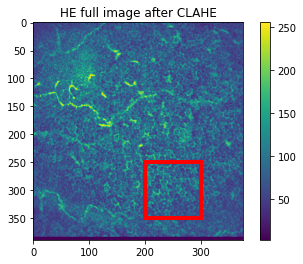

max, min of small image is  211 29 87.1051
50.233333333333334 104.83333333333333


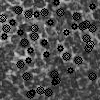

single pixel =  [95 95 95]


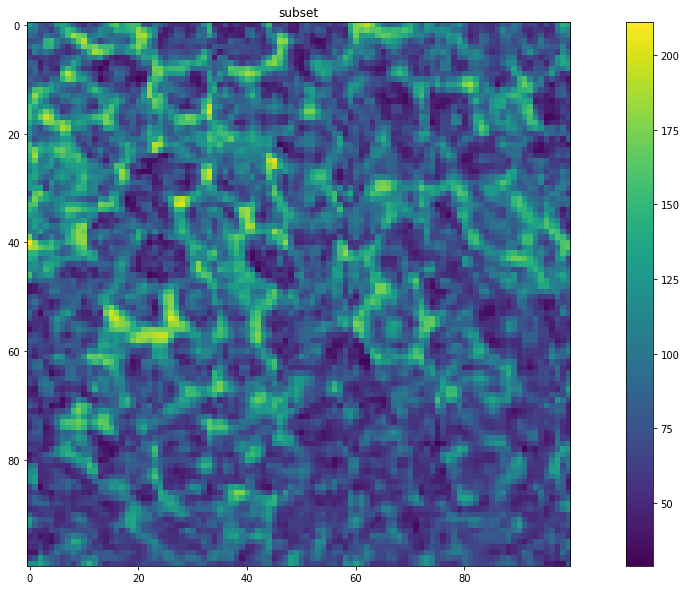

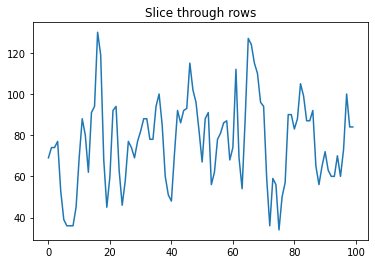

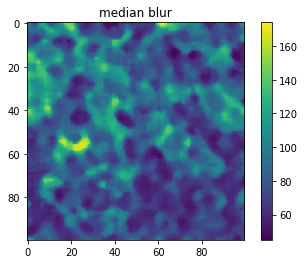

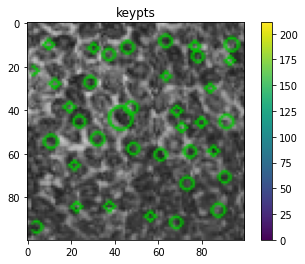

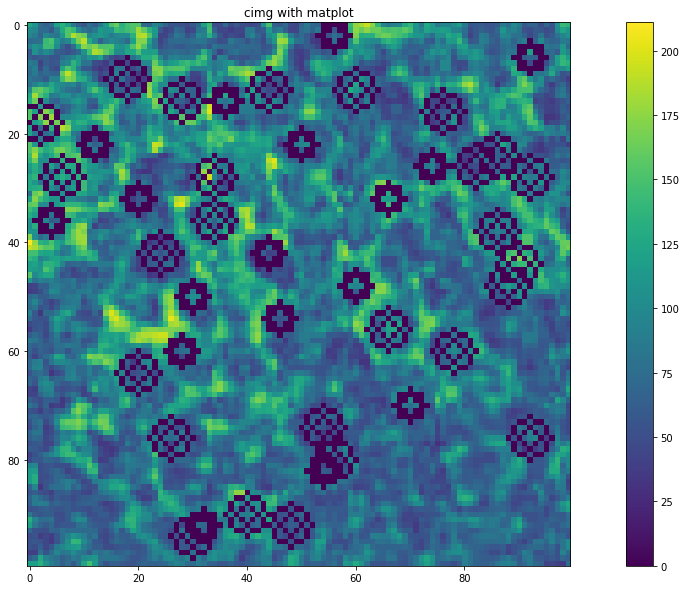

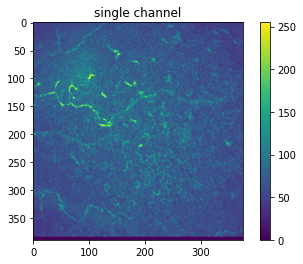

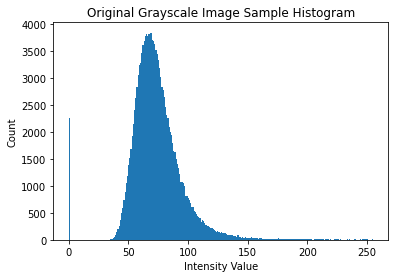

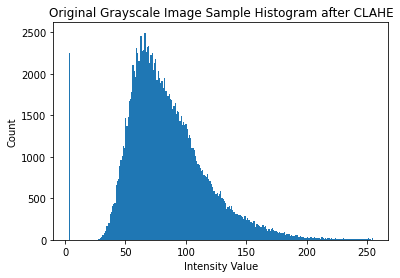

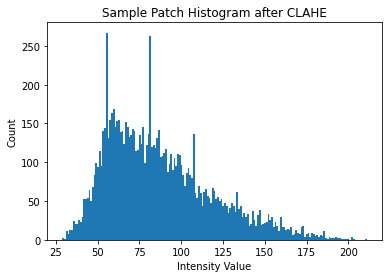

Text(0.5, 1.0, 'Filled 2')

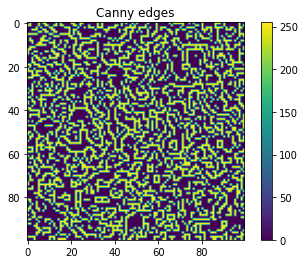

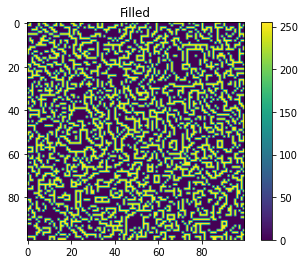

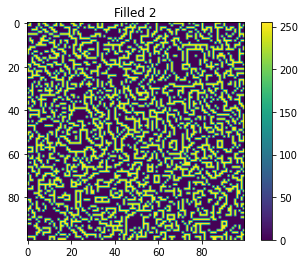

In [103]:
################################################################################
# Scratch area for debug and single plots
#
#
################################################################################

#a = im['Severe']['Anonymized']['87-38']['87-38-35.jpg']
#f = '/content/gdrive/My Drive/BE224B_2020/Central BCD4/Severe/Anonymized/87-38/87-38-35.jpg'



#f='/content/gdrive/My Drive/BE224B_2020/Central BCD4/Mild/Anonymized/12-0/12-0-34.jpg'
f='/content/gdrive/My Drive/BE224B_2020/Central BCD4/Mild/Anonymized/74-2/74-2-18.jpg'
#Severe/Anonymized/14-6/14-6-23.jpg'
#/home/kgonzalez/BE224B_2020/Central BCD4/Mild/Anonymized/74-2

rgb =  imageio.imread(f)

gray_image = np.dot(rgb[...,:3], [0.299, 0.587, 0.114])
original_gray = gray_image.copy()

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
gray_image = clahe.apply(np.uint8(gray_image))
print(np.shape(rgb))

plt.figure()
plt.imshow(gray_image)
plt.colorbar()
plt.title('HE full image after CLAHE')
rect = patches.Rectangle((200,250),100,100,linewidth=4,edgecolor='r',facecolor='none')

# Get the current reference
ax = plt.gca()
# Add the patch to the Axes
ax.add_patch(rect)
plt.show()



small_image = gray_image[250:350,200:300]
max_i = np.max(small_image)
min_i = np.min(small_image)
mean = np.mean(small_image)
print('max, min of small image is ',max_i,min_i,mean)




fwhm=get_fwhm(small_image,30)
low_contrast = fwhm[0]
high_contrast = fwhm[-1]
########################################################################
#HISTOGRAM
#

print(low_contrast, high_contrast)

#####################################################################




plt.figure(figsize=(20,10))
plt.imshow(small_image)
plt.title('subset')
plt.colorbar()

line = small_image[:,50]
plt.figure()
plt.plot(line)
plt.title('Slice through rows')


blur = cv2.medianBlur(small_image,5)
plt.figure()
plt.imshow(blur)
plt.colorbar()
plt.title('median blur')


params = cv2.SimpleBlobDetector_Params()
# Change thresholds
params.minThreshold = low_contrast #10;
params.maxThreshold = high_contrast #200;
# Filter by Area.
params.filterByArea = True
params.minArea = 10
# Filter by Circularity
params.filterByCircularity = True
params.minCircularity = 0.5
# Filter by Convexity
params.filterByConvexity = True
params.minConvexity = 0.75 #0.87
# Filter by Inertia
params.filterByInertia = True
params.minInertiaRatio = 0.05 #0.01
# Create a detector with the parameters
ver = (cv2.__version__).split('.')
if int(ver[0]) < 3 :
    detector = cv2.SimpleBlobDetector(params)
else :
    detector = cv2.SimpleBlobDetector_create(params)



# Set up the detector with default parameters.
#detector = cv2.SimpleBlobDetector_create() #SimpleBlobDetector()

 
# Detect blobs.
keypoints = detector.detect(small_image)
im_with_keypoints = cv2.drawKeypoints(small_image, keypoints, np.array([]), (0,200,0), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure()
plt.imshow(im_with_keypoints)
plt.colorbar()
plt.title('keypts')


circles = cv2.HoughCircles(small_image,cv2.HOUGH_GRADIENT,1,3,
                            param1=high_contrast,param2=7,minRadius=3,maxRadius=5)
circles = np.uint16(np.around(circles))







from google.colab.patches import cv2_imshow
cimg = small_image.copy() #gray_image.copy()
for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(cimg,(i[0],i[1]),i[2],(0,255,0),1)
    # draw the center of the circle
    cv2.circle(cimg,(i[0],i[1]),2,(0,200,255),1)

cv2_imshow(cimg)
cv2.waitKey(0)
cv2.destroyAllWindows()


plt.figure(figsize=(20,10))
plt.imshow(cimg)
plt.title('cimg with matplot')
plt.colorbar()

plt.figure()
plt.imshow(rgb[:,:,2])
plt.colorbar()
plt.title('single channel')

print('single pixel = ', rgb[150,180,:])



plt.figure()
ax = plt.hist(original_gray.ravel(), bins = 256)
plt.title('Original Grayscale Image Sample Histogram')
plt.ylabel('Count')
plt.xlabel('Intensity Value')
plt.show()




plt.figure()
ax = plt.hist(gray_image.ravel(), bins = 253)
plt.title('Original Grayscale Image Sample Histogram after CLAHE')
plt.ylabel('Count')
plt.xlabel('Intensity Value')
plt.show()

plt.figure()
ax = plt.hist(small_image.ravel(), bins = 175)
plt.title('Sample Patch Histogram after CLAHE')
plt.ylabel('Count')
plt.xlabel('Intensity Value')
plt.show()







sq2 = rgb[50:150,50:150]
med = np.median(sq2)
max2 = np.max(sq2)
edges = cv2.Canny(np.uint8(small_image),low_contrast, high_contrast) #max2*0.85,max2)

plt.figure()
plt.imshow(edges)
plt.colorbar()
plt.title('Canny edges')




matrix_np = np.asarray(edges)
numeric_matrix = np.where(matrix_np>0,1,0)
mask = np.zeros(np.asarray(numeric_matrix.shape)+2, dtype=np.uint8)
start_pt = (43,63) #y,x)
if matrix_np[start_pt]:
  cv2.floodFill(numeric_matrix, mask, start_pt, 255, flags=4)
mask = mask[1:-1, 1:-1]
matrix_np[mask==1] = 1 #"c"
matrix = matrix_np.tolist()


edges_temp = edges.copy()
cv2.floodFill(edges_temp, None, seedPoint=(63,43), newVal=1, loDiff=(5, 5, 5, 5), upDiff=(5, 5, 5, 5))

plt.figure()
plt.imshow(matrix_np)
plt.colorbar()
plt.title('Filled')

plt.figure()
plt.imshow(edges_temp)
plt.colorbar()
plt.title('Filled 2')


In [104]:
# Debug alternate Canny methods
import numpy as np
import argparse
import glob
import cv2
def auto_canny(image, sigma=0.33):
	# compute the median of the single channel pixel intensities
	v = np.median(image)
	# apply automatic Canny edge detection using the computed median
	lower = int(max(0, (1.0 - sigma) * v))
	upper = int(min(255, (1.0 + sigma) * v))
	edged = cv2.Canny(image, lower, upper)
	# return the edged image
	return edged

Text(0.5, 1.0, 'canny')

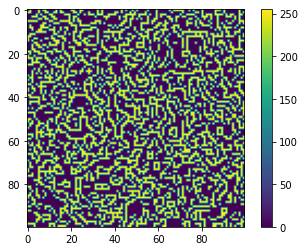

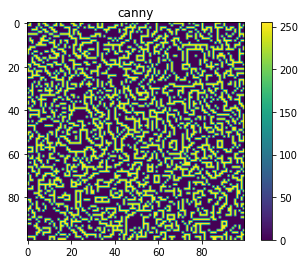

In [105]:
x = auto_canny(small_image)

plt.figure()
plt.imshow(x)
plt.colorbar()

plt.figure()
plt.imshow(edges)
plt.colorbar()
plt.title('canny')

In [106]:
################################################################################
# Scratch area for canny and histogram testing
################################################################################
if (0):
    print(hist)
    print(bedges)

    print(np.size(hist))
    print(np.size(bedges))
    plt.bar(bedges[:-1], hist,width=np.diff(bedges), edgecolor="black", align="edge")

    max_val = max(hist)
    center = np.argwhere(hist == max_val)
    center_value = hist[center]
    print('center is ', center[0])
    #print(hist[center[[0]]-2:center[[0]]+2])


    bins = bedges
    n=hist
    mids = 0.5*(bins[1:] + bins[:-1])
    probs = n / np.sum(n)

    mean = np.sum(probs * mids)  
    sd = np.sqrt(np.sum(probs * (mids - mean)**2))
    print('standard deviation = ',sd)

    fwhm = []
    dx = np.diff(bins)
    for count, ii in enumerate(hist):
        if (ii >= center_value/2.0):
            midbin = bins[count] + dx[0]/2 #bins[count]- bins[count-1]
            fwhm.append(midbin)

    print(fwhm)

sharpness is  4.743985219165623


"\n#im = Image.open(filename).convert('L') # to grayscale\narray = np.asarray(im, dtype=np.int32)\n\ngy, gx = np.gradient(array)\ngnorm = np.sqrt(gx**2 + gy**2)\nsharpness = np.average(gnorm)\n"

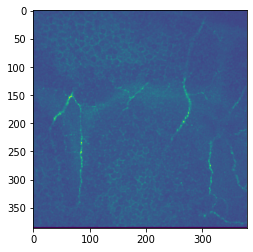

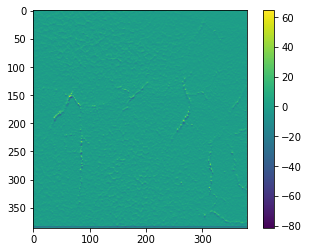

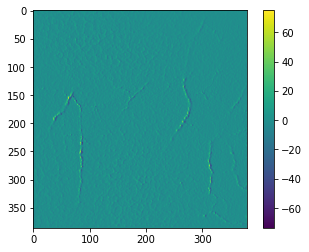

In [107]:
a = im['Control']['Anonymized']['N3-2']['N3-2-32.jpg']
plt.figure()
plt.imshow(a)

'''
red = a[:,:,0]
green = a[:,:,1]
blue = a[:,:,2]



gray = 0.2989 * red + 0.5870 * green + 0.1140 * blue
g2=np.dot(a[...,:3], [0.299, 0.587, 0.114])
'''


gy,gx = np.gradient(a)

gnorm = np.sqrt(gx**2 + gy**2)
sharpness_number = np.average(gnorm)

print('sharpness is ',sharpness_number)

plt.figure()
plt.imshow(gy)
plt.colorbar()


plt.figure()
plt.imshow(gx)
plt.colorbar()

'''
#im = Image.open(filename).convert('L') # to grayscale
array = np.asarray(im, dtype=np.int32)

gy, gx = np.gradient(array)
gnorm = np.sqrt(gx**2 + gy**2)
sharpness = np.average(gnorm)
'''


In [108]:
#print out ordered file listing from csv data
for id_number,name in enumerate(ordered_files):
    if (name == '76-7-26.jpg'):
        box_data = table_data[id_number][5:9]
        user_right = int(box_data[0])
        user_left = int(box_data[1])
        user_top = int(box_data[2])
        user_bottom = int(box_data[3])
        user_x = user_right - user_left
        user_y = user_top - user_bottom
        user_data_found = 1 #allow the user patch to be created
        area = user_x * user_y

        print(name)
        print(area)
        print(user_x, user_y)

76-7-26.jpg
8325
185 45


In [ ]:
def animate_image(gdir,image_dir):
    import matplotlib.animation as animation
    import os
import glob
for name in glob.glob('dir/*'):
    print name


    fstring = '4-1-22'

    
    plt.close()
    plt.rcParams["animation.html"] = "jshtml"

    #plt.figure()
    #plt.imshow(stack[:,:,300])
    fig=plt.figure()
    #plt.imshow(stack[:,:,255])
    ims = []
    dir_name = os.path.join(gdir,'ANIMATE_BCD4') #"/home/kgonzalez/IMAGES"



    base_filename = "figure"
    filename_suffix = ".png"
    for ii in range(0,512):
            im = plt.imshow(stack[:,:,ii], animated=True)
            ims.append([im])
            plt.imshow(stack[:,:,ii],cmap='gray')
            name = os.path.join(dir_name, base_filename + str(ii).zfill(5)  + filename_suffix)
            
            plt.savefig(name) # save as png

    ani = animation.ArtistAnimation(fig, ims, interval=1000, blit=True,
                                    repeat_delay=500)
    #plt.show()
    #ani.save('dynamic_images.mp4')
